## MSDS453 - Research Assignment 02 - Classification and Clustering

Clustering methods compute a similarity (or closeness) measure, such as Euclidean distance, in order to decide whether two documents are ‘similar’ or not.  

Use the entire class corpus and do sentiment analysis for the positive and negative reviews.

Topic modeling is another way to group ‘similar’ documents into ‘clusters’. 

In [1]:
import pandas as pd
import os
import numpy as np
import re
import string
import seaborn as sns
import matplotlib.pyplot as plt
import nltk
import random
from dataclasses import dataclass

from nltk.corpus import stopwords
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.stem import PorterStemmer

import gensim
from gensim import corpora, similarities
from gensim.models import Word2Vec, LdaMulticore, TfidfModel, CoherenceModel
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
from gensim.models import LsiModel,LdaModel

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.manifold import TSNE, MDS
from sklearn.cluster import KMeans
from sklearn.metrics import roc_auc_score, accuracy_score, confusion_matrix, silhouette_score
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split, KFold
from sklearn.naive_bayes import MultinomialNB

from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score

import scipy.cluster.hierarchy

from IPython.display import display, HTML

from typing import List, Callable, Dict

### Mount Google Drive to Colab Environment

<div class="alert alert-block alert-success">
    <b>Directories Required for Research Assignment</b>:<br> 
1. Data Directory - Source Class Corpus Data<br>
2. Output Directory - Vocabulary<br>
</div>

#### Uncomment To Map Drive

In [2]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


### NLTK Downloads

In [3]:
# Only run this once, they will be downloaded.
nltk.download('stopwords',quiet=True)
nltk.download('wordnet',quiet=True)
nltk.download('punkt',quiet=True)
nltk.download('omw-1.4',quiet=True)

True

<div class="alert alert-block alert-danger">
<b>Gensim</b> is a Python library for topic modelling, document indexing and similarity retrieval with large corpora. Target audience is the natural language processing (NLP) and information retrieval (IR) community <br><br>
    <b>https://pypi.org/project/gensim/ </b>
</div>

In [4]:
import pkg_resources
pkg_resources.require("gensim<=3.8.3");

In [5]:
print("Genism Version: ", gensim.__version__)

Genism Version:  3.6.0


<div class="alert alert-block alert-info">
    <b>Suppress warning messages</b></div>

In [6]:
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn

## Data Wrangling Utility Functions

In [7]:
def add_movie_descriptor(data: pd.DataFrame, corpus_df: pd.DataFrame):
    """
    Adds "Movie Description" to the supplied dataframe, in the form {Genre}_{P|N}_{Movie Title}_{DocID}
    """
    review = np.where(corpus_df['Review Type (pos or neg)'] == 'Positive', 'P', 'N')
    data['Descriptor'] = corpus_df['Genre of Movie'] + '_' + corpus_df['Movie Title'] + '_' + review + '_' + corpus_df['Doc_ID'].astype(str)

def get_corpus_df(path):
    data = pd.read_csv(path)
    add_movie_descriptor(data, data)
    sorted_data = data.sort_values(['Descriptor'])
    indexed_data = sorted_data.set_index(['Doc_ID'])
    indexed_data['Doc_ID'] = indexed_data.index
    return indexed_data

@dataclass
class Document:
    doc_id: str
    text: str

def normalize_document(document: Document) -> Document:
    text = document.text
    text = remove_punctuation(text)
    text = lower_case(text)
    text = remove_tags(text)
    text = remove_special_chars_and_digits(text)
    
    return Document(document.doc_id, text)

def normalize_documents(documents: List[Document]) -> List[Document]:
    """
    Normalizes text for all given documents.
    Removes punctuation, converts to lower case, removes tags and special characters.
    """
    return [normalize_document(x) for x in documents]

@dataclass
class TokenizedDocument:
    doc_id: str
    tokens: List[str]

def tokenize_document(document: Document) -> TokenizedDocument:
    tokens = nltk.word_tokenize(document.text)
    return TokenizedDocument(document.doc_id, tokens)

def tokenize_documents(documents: List[Document]) -> List[TokenizedDocument]:
    return [tokenize_document(x) for x in documents]

def lemmatize(documents: List[TokenizedDocument]) -> List[TokenizedDocument]:
    result = []
    lemmatizer = WordNetLemmatizer()
    for document in documents:
        output_tokens = [lemmatizer.lemmatize(w) for w in document.tokens]
        result.append(TokenizedDocument(document.doc_id, output_tokens))
        
    return result

# def stem(documents: List[TokenizedDocument]) -> List[TokenizedDocument]:
#     result = []
#     stemmer = PorterStemmer()
#     for document in documents:
#         output_tokens = [stemmer.stem(w) for w in document.tokens]
#         result.append(TokenizedDocument(document.doc_id, output_tokens))

#     return result

def remove_stop_words(documents: List[TokenizedDocument]) -> List[TokenizedDocument]:
    result = []
    
    stop_words = set(nltk.corpus.stopwords.words('english')) 
    for document in documents:
        filtered_tokens = [w for w in document.tokens if not w in stop_words]
        result.append(TokenizedDocument(document.doc_id, filtered_tokens))
        
    return result
    
def add_flags(data: pd.DataFrame, us_doc_ids: List[int], horror_doc_ids: List[int]):
    data['is_us'] = data.index.isin(us_doc_ids)
    data['is_horror'] = data.index.isin(horror_doc_ids)
    
def get_all_tokens(documents: List[TokenizedDocument]) -> List[str]:
    tokens = {y for x in documents for y in x.tokens}
    return sorted(list(tokens))

def clean_doc(doc): 
    #split document into individual words
    tokens=doc.split()
    re_punc = re.compile('[%s]' % re.escape(string.punctuation))
    # remove punctuation from each word
    tokens = [re_punc.sub('', w) for w in tokens]
    # remove remaining tokens that are not alphabetic
    tokens = [word for word in tokens if word.isalpha()]
    # filter out short tokens
    tokens = [word for word in tokens if len(word) > 4]
    #lowercase all words
    tokens = [word.lower() for word in tokens]
    # filter out stop words
    stop_words = stopwords.words('english')
    new_words = ['movie','story','films']
    stop_words.extend(new_words)
    all_stop_words = set(stop_words)
    tokens = [w for w in tokens if not w in all_stop_words]         
    # lemmatize
    wnl = WordNetLemmatizer()
    tokens=[wnl.lemmatize(word) for word in tokens]
    return tokens

def final_processed_text(doc):
    #this is a function to join the processed text back
    ' '.join(doc)
    return doc

def tfidf(corpus, titles, ngram_range = (1,1)):
    #this is a function to created the tfidf matrix
    Tfidf=TfidfVectorizer(ngram_range=(1,1))

    #fit the vectorizer using final processed documents.  The vectorizer requires the 
    #stiched back together document.

    TFIDF_matrix=Tfidf.fit_transform(corpus)     

    #creating datafram from TFIDF Matrix
    words = Tfidf.get_feature_names()
    matrix=pd.DataFrame(TFIDF_matrix.toarray(), columns=Tfidf.get_feature_names(), index=titles)
    return matrix ,words

def One_Hot(variable):
    #this is a function to one hot encode the classes
    LE=LabelEncoder()
    LE.fit(variable)
    Label1=LE.transform(variable)
    OHE=OneHotEncoder()
    labels=OHE.fit_transform(Label1.reshape(-1,1)).toarray()
    return labels

## Functions Latent Semantic Analysis, Latent Dirichlet Allocation, Word2Vec Matrix



In [8]:
def create_gensim_lsa_model(doc_clean,number_of_topics,words):

    # Creating the term dictionary of our courpus, where every unique term is assigned an index
    dictionary = corpora.Dictionary(doc_clean)
    # Converting list of documents (corpus) into Document Term Matrix using dictionary prepared above
    doc_term_matrix = [dictionary.doc2bow(doc) for doc in doc_clean]
    # generate LSA model
    lsamodel = LsiModel(doc_term_matrix, num_topics=number_of_topics, id2word = dictionary)  # train model
    print(lsamodel.print_topics(num_topics=number_of_topics, num_words=words))
    index = similarities.MatrixSimilarity(lsamodel[doc_term_matrix])

    return lsamodel,dictionary,index

def lsa(tfidf_matrix, terms, n_components = 10):
    #this is a function to execute lsa.
    #inputs to the function include the tfidf matrix and the desired number of components.
    
    LSA = TruncatedSVD(n_components=10)
    LSA.fit(tfidf_matrix)

    for i, comp in enumerate(LSA.components_):
        terms_comp = zip(terms, comp)
        sorted_terms = sorted(terms_comp, key= lambda x:x[1], reverse=True)[:7]
        print("Topic "+str(i)+": ")
        for t in sorted_terms:
            print(t[0])

def create_gensim_lda_model(doc_clean,number_of_topics,words, iterations):

    # Creating the term dictionary of our courpus, where every unique term is assigned an index. dictionary = corpora.Dictionary(doc_clean)
    dictionary = corpora.Dictionary(doc_clean)
    # Converting list of documents (corpus) into Document Term Matrix using dictionary prepared above.
    doc_term_matrix = [dictionary.doc2bow(doc) for doc in doc_clean]
    # generate LDA model
    ldamodel = LdaModel(doc_term_matrix, num_topics=number_of_topics, id2word = dictionary, iterations=iterations)
    # train model
    print(ldamodel.print_topics(num_topics=number_of_topics, num_words=words))
    index = similarities.MatrixSimilarity(ldamodel[doc_term_matrix])
    return ldamodel,dictionary,index,doc_term_matrix

def lda(tfidf_matrix, terms, topics = 3, num_words = 10):
    #this is a function to perform lda on the tfidf matrix.  function varibales include:
    #tfidf matrix, desired number of topic, and number of words per topic.

    topics = 3
    num_words = 10
    lda = LatentDirichletAllocation(n_components=topics).fit(tfidf_matrix)

    topic_dict = {}
    for topic_num, topic in enumerate(lda.components_):
        topic_dict[topic_num] = " ".join([terms[i]for i in topic.argsort()[:-num_words - 1:-1]])

    print(topic_dict)            


def word2vec(processed_text, size = 100):
    #This is a function to generate the word2vec matrix. 
    #Input parameters include the tokenized text and matrix size
    
    #word to vec
    model_w2v = Word2Vec(processed_text, size=100, window=5, min_count=1, workers=4)

    #join all processed DSI words into single list
    processed_text_w2v=[]
    for i in processed_text:
        for k in i:
            processed_text_w2v.append(k)

    #obtain all the unique words from DSI
    w2v_words=list(set(processed_text_w2v))

    #can also use the get_feature_names() from TFIDF to get the list of words
    w2v_words=Tfidf.get_feature_names()

    #empty dictionary to store words with vectors
    w2v_vectors={}

    #for loop to obtain weights for each word
    for i in w2v_words:
        temp_vec=model_w2v.wv[i]
        w2v_vectors[i]=temp_vec

   #create a final dataframe to view word vectors
    w2v_df=pd.DataFrame(w2v_vectors).transpose()
    print(w2v_df)
    return w2v_df


## Modeling Functions: KMeans

In [9]:
def k_means(titles, tfidf_matrix, k=10):
    
    #this is a function to generate the k-means output using the tfidf matrix.  
    #Inputs to the function include: titles of text, processed text, and desired k value. 
    #Returns dataframe indicating cluster number per document

    km = KMeans(n_clusters=k, random_state =89)
    km.fit(tfidf_matrix)
    clusters = km.labels_.tolist()

    Dictionary={'Doc Name':titles, 'Cluster':clusters,  'Text': final_processed_text}
    frame=pd.DataFrame(Dictionary, columns=['Cluster', 'Doc Name','Text'])
    #dictionary to store clusters and respective titles
    cluster_title={}

    #doc2vec clusters will not have individual words due to the vector representation is based on the entire document not indvidual words. 
    #As a result, there won't be individual word outputs from each cluster.   
    for i in range(k):
        temp=frame[frame['Cluster']==i]
        temp_title_list=[]
        for title in temp['Doc Name']:
            temp_title_list.append(title)
        cluster_title[i]=temp_title_list

    return cluster_title,clusters,frame

In [10]:

def k_means_tfidf(tfidf_matrix,terms,titles,final_processed_text, k=10):
    
    #this is a function to generate the k-means output using the tfidf matrix.  Inputs 
    #to the function include: titles of text, processed text, and desired k value. 
    km = KMeans(n_clusters=k, random_state =89)
    km.fit(tfidf_matrix)
    clusters = km.labels_.tolist()

    Dictionary={'Doc Name':titles, 'Cluster':clusters,  'Text': final_processed_text}
    frame=pd.DataFrame(Dictionary, columns=['Cluster', 'Doc Name','Text'])

    print("Top terms per cluster:")
    #sort cluster centers by proximity to centroid
    order_centroids = km.cluster_centers_.argsort()[:, ::-1] 

    terms_dict=[]


    #save the terms for each cluster and document to dictionaries.  To be used later
    #for plotting output.

    #dictionary to store terms and titles
    cluster_terms={}
    cluster_title={}


    for i in range(k):
        print("Cluster %d:" % i),
        temp_terms=[]
        temp_titles=[]
        for ind in order_centroids[i, :10]:
            print(' %s' % terms[ind])
            terms_dict.append(terms[ind])
            temp_terms.append(terms[ind])
        cluster_terms[i]=temp_terms

        print("Cluster %d titles:" % i, end='')
        temp=frame[frame['Cluster']==i]
        for title in temp['Doc Name']:
            print(' %s,' % title, end='')
            temp_titles.append(title)
        cluster_title[i]=temp_titles   




In [11]:
def classifiers(x, y, model_type, cv = 3):
    
    #this function is to fit 3 different model scenarios.  Support vector machines, logistic regressions, naive bayes.
    #svm = Support vector machin
    #logistic = Logistic regression
    #naive_bayes = Naive Bayes Multinomial
    
    #can define cv value for cross validation.
    
    #function returns the train test split scores of each model.
    
    if model_type == 'svm':
        print("svm")
        model = SVC()

    elif model_type == 'logistic':
        print("logistic")
        model = LogisticRegression()

    elif model_type == 'naive_bayes':
        print("naive_bayes")
        model = MultinomialNB()
    
    elif model_type == 'randomforest':
        print("randomforest")
        model = RandomForestClassifier()

    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=42)
    model.fit(X_train, y_train)
    
    predictions = model.predict(X_test)
    accy = accuracy_score(y_test, predictions) 
    return accy        

## Visualization Utility Functions

In [12]:
#Visualization utility functions LSA

def plot_lsa(number_of_topics, words):

    model,dictionary,index=create_gensim_lsa_model(processed_text,number_of_topics,words)

    for doc in processed_text:
        vec_bow = dictionary.doc2bow(doc)
        vec_lsi = model[vec_bow]  # convert the query to LSI space
        sims = index[vec_lsi] # perform a similarity query against the corpus

    fig, ax = plt.subplots(figsize=(40, 45))
    cax = ax.matshow(index, interpolation='nearest')
    ax.grid(True)
    plt.xticks(range(len(processed_text)), titles, rotation=90);
    plt.yticks(range(len(processed_text)), titles);
    fig.colorbar(cax)
    plt.show()
    return model  


#Visualization utility functions tf-idf


def plot_tfidf_matrix(cluster_title,clusters,TFIDF_matrix):
    # convert two components as we're plotting points in a two-dimensional plane
    # "precomputed" because we provide a distance matrix
    # "random_state" for reproductibility of the plot

    mds = MDS(n_components=2, dissimilarity="precomputed", random_state=1)
    dist = 1 - cosine_similarity(TFIDF_matrix)
    pos = mds.fit_transform(dist)  # shape (n_components, n_samples)
    xs, ys = pos[:, 0], pos[:, 1]

    #set up colors per clusters using a dict.  number of colors must correspond to K
    cluster_colors = {0: 'black', 1: 'grey', 2: 'blue', 3: 'rosybrown', 4: 'firebrick', 
                      5:'red', 6:'darksalmon', 7:'sienna'}

    #set up cluster names using a dict.  
    cluster_dict=cluster_title

    #create data frame that has the result of the MDS plus the cluster numbers and titles
    df = pd.DataFrame(dict(x=xs, y=ys, label=clusters, title=range(0,len(clusters)))) 

    #group by cluster
    groups = df.groupby('label')

    fig, ax = plt.subplots(figsize=(15,15)) # set size
    ax.margins(0.05) # Optional, just adds 5% padding to the autoscaling

    #iterate through groups to layer the plot
    #note that I use the cluster_name and cluster_color dicts with the 'name' lookup to return the appropriate color/label
    
    for name, group in groups:
        r = random.random()
        b = random.random()
        g = random.random()
        color = (r, g, b)
        
        ax.plot(group.x, group.y, marker='o', linestyle='', ms=12,
                label=cluster_dict[name], color=color, 
                mec='none')
        ax.set_aspect('auto')
        ax.tick_params(\
            axis= 'x',         # changes apply to the x-axis
            which='both',      # both major and minor ticks are affected
            bottom='off',      # ticks along the bottom edge are off
            top='off',         # ticks along the top edge are off
            labelbottom='on')
        ax.tick_params(\
            axis= 'y',         # changes apply to the y-axis
            which='both',      # both major and minor ticks are affected
            left='off',        # ticks along the bottom edge are off
            top='off',         # ticks along the top edge are off
            labelleft='on')

    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), prop={'size': 30})      #show legend with only 1 point

 
 

## Loading the Class Corpus

In [13]:
#read in class corpus csv into python
data=pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/MSDS_453_Public-main/MSDS453_ClassCorpus/MSDS453_ClassCorpus_Final_Sec56_v4_20230115.csv')

#adding two columns to the dataframe to store the processed text and tokenized text
data['processed_text'] = data['Text'].apply(lambda x: clean_doc(x))

#creating final processed text variables for matrix creation
final_processed_text = [' '.join(x) for x in data['processed_text'].tolist()]
titles = data['DSI_Title'].tolist()
processed_text = data['processed_text'].tolist()

# #generate tfidf for analysis
tfidf_matrix, terms = tfidf(final_processed_text, titles, ngram_range = (1,1))

## Exploratory Data Analysis

In [14]:
CORPUS_PATH = '/content/gdrive/MyDrive/Colab Notebooks/MSDS_453_Public-main/MSDS453_ClassCorpus/MSDS453_ClassCorpus_Final_Sec56_v4_20230115.csv'
corpus_df = get_corpus_df(CORPUS_PATH)
documents = [Document(x, y) for x, y in zip(corpus_df.Doc_ID, corpus_df.Text)]

In [15]:
corpus_df.shape

(200, 9)

In [16]:
corpus_df.head().T

Doc_ID,191,192,193,195,198
DSI_Title,LLQ_Doc1_AngelHasFallen,LLQ_Doc2_AngelHasFallen,LLQ_Doc3_AngelHasFallen,LLQ_Doc5_AngelHasFallen,LLQ_Doc8_AngelHasFallen
Submission File Name,LLQ_Doc1_AngelHasFallen,LLQ_Doc2_AngelHasFallen,LLQ_Doc3_AngelHasFallen,LLQ_Doc5_AngelHasFallen,LLQ_Doc8_AngelHasFallen
Student Name,LLQ,LLQ,LLQ,LLQ,LLQ
Genre of Movie,Action,Action,Action,Action,Action
Review Type (pos or neg),Negative,Negative,Negative,Negative,Negative
Movie Title,Angel Has Fallen,Angel Has Fallen,Angel Has Fallen,Angel Has Fallen,Angel Has Fallen
Text,Ric Roman Waugh's Angel Has Fallen sees U.S. S...,"The sleepy, dopey action bonanza ""Angel Has Fa...",There is a certain mindless pleasure in the Fa...,"No, you don't need to have seen ""Olympus Has F...",No one has ever accused a Gerard Butler action...
Descriptor,Action_Angel Has Fallen_N_191,Action_Angel Has Fallen_N_192,Action_Angel Has Fallen_N_193,Action_Angel Has Fallen_N_195,Action_Angel Has Fallen_N_198
Doc_ID,191,192,193,195,198


In [17]:
print(corpus_df.info() )

<class 'pandas.core.frame.DataFrame'>
Int64Index: 200 entries, 191 to 295
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   DSI_Title                 200 non-null    object
 1   Submission File Name      200 non-null    object
 2   Student Name              200 non-null    object
 3   Genre of Movie            200 non-null    object
 4   Review Type (pos or neg)  200 non-null    object
 5   Movie Title               200 non-null    object
 6   Text                      200 non-null    object
 7   Descriptor                200 non-null    object
 8   Doc_ID                    200 non-null    int64 
dtypes: int64(1), object(8)
memory usage: 15.6+ KB
None


In [18]:
# print(len(tfidf_words))
# type(tfidf_words)

## Latent Semantic Analysis (LSA) Analysis - Research Number of Topics and Number of Words

[(0, '0.240*"character" + 0.165*"first" + 0.140*"action" + 0.136*"scene" + 0.135*"would" + 0.128*"thing" + 0.127*"movie" + 0.122*"year" + 0.107*"doesnt" + 0.107*"batman"'), (1, '0.604*"batman" + 0.239*"penguin" + 0.229*"burton" + 0.176*"return" + 0.168*"catwoman" + 0.161*"gotham" + 0.145*"shreck" + 0.145*"dream" + 0.108*"christopher" + 0.104*"villain"'), (2, '0.241*"dream" + 0.195*"action" + 0.194*"inception" + -0.160*"batman" + 0.145*"anderton" + 0.138*"future" + -0.134*"funny" + -0.134*"comedy" + 0.132*"cruise" + 0.127*"spielberg"'), (3, '-0.304*"dream" + -0.230*"inception" + -0.186*"fallen" + -0.183*"banning" + 0.182*"black" + -0.182*"action" + 0.165*"pitch" + 0.157*"planet" + 0.155*"alien" + 0.136*"riddick"')]


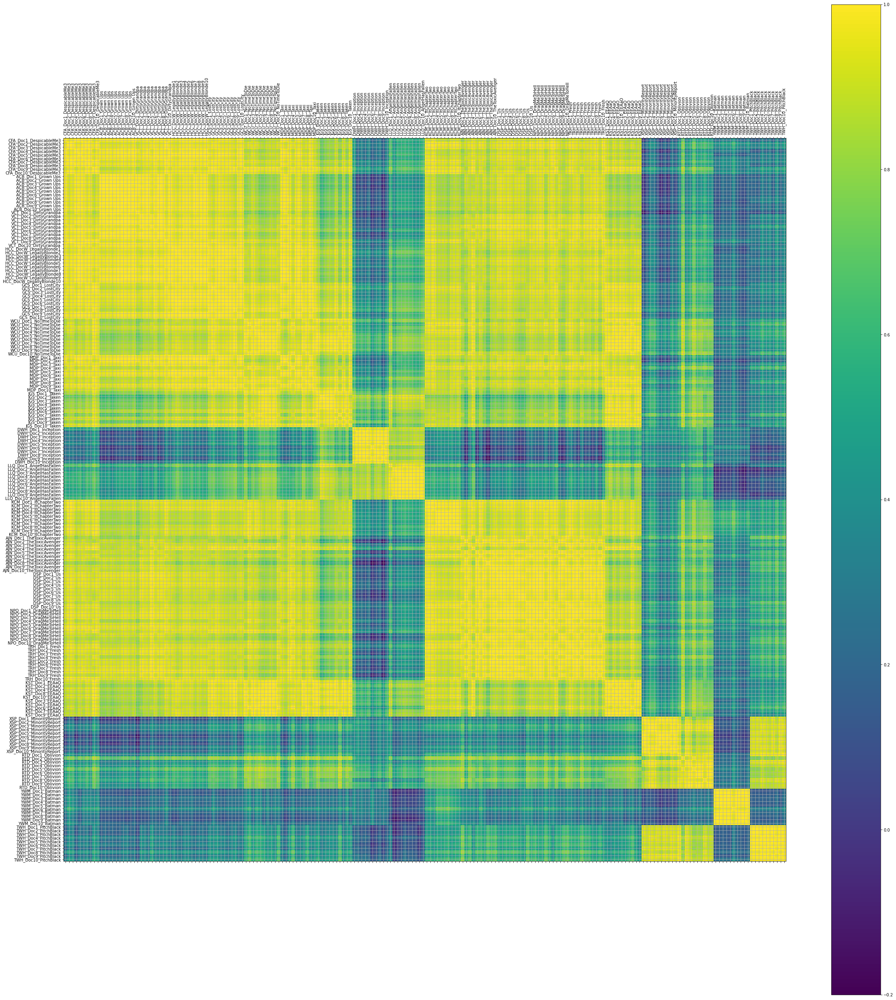

In [19]:
model_4topic_10words = plot_lsa(4, 10)

[(0, '0.240*"character" + 0.165*"first" + 0.140*"action" + 0.136*"scene" + 0.135*"would" + 0.128*"thing" + 0.127*"movie" + 0.122*"year" + 0.107*"doesnt" + 0.107*"batman"'), (1, '0.604*"batman" + 0.239*"penguin" + 0.229*"burton" + 0.176*"return" + 0.168*"catwoman" + 0.161*"gotham" + 0.145*"shreck" + 0.145*"dream" + 0.108*"christopher" + 0.103*"villain"'), (2, '0.240*"dream" + 0.195*"action" + 0.194*"inception" + -0.161*"batman" + 0.144*"anderton" + 0.139*"future" + -0.134*"comedy" + -0.133*"funny" + 0.132*"cruise" + 0.127*"spielberg"'), (3, '-0.305*"dream" + -0.230*"inception" + -0.186*"fallen" + -0.184*"banning" + 0.182*"black" + -0.181*"action" + 0.165*"pitch" + 0.156*"alien" + 0.155*"planet" + 0.136*"riddick"'), (4, '-0.366*"fallen" + -0.341*"banning" + 0.285*"dream" + -0.222*"angel" + 0.212*"inception" + -0.193*"president" + 0.126*"nolan" + -0.123*"butler" + 0.105*"blonde" + -0.104*"agent"')]


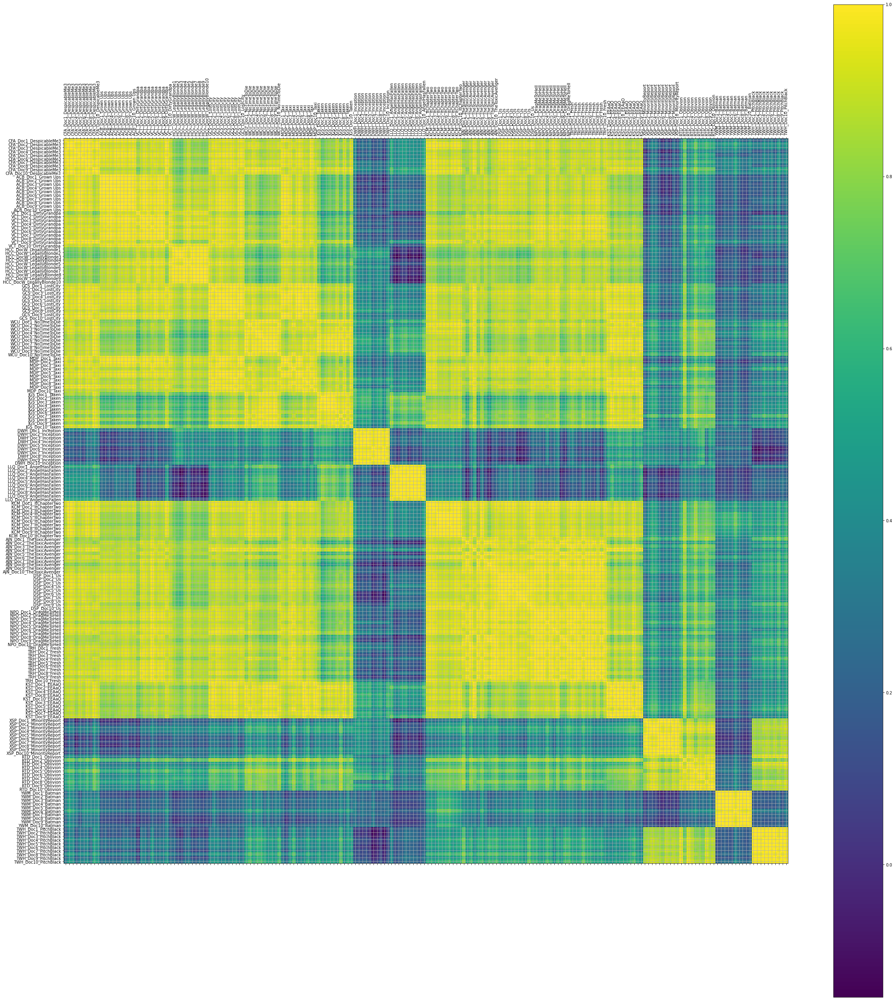

In [20]:
model_5topic_10words = plot_lsa(5, 10)

[(0, '-0.240*"character" + -0.165*"first" + -0.140*"action" + -0.136*"scene" + -0.135*"would" + -0.128*"thing" + -0.127*"movie" + -0.122*"year" + -0.107*"doesnt" + -0.107*"batman"'), (1, '-0.604*"batman" + -0.239*"penguin" + -0.229*"burton" + -0.176*"return" + -0.169*"catwoman" + -0.161*"gotham" + -0.145*"shreck" + -0.145*"dream" + -0.108*"christopher" + -0.103*"villain"'), (2, '-0.241*"dream" + -0.195*"action" + -0.194*"inception" + 0.161*"batman" + -0.144*"anderton" + -0.139*"future" + 0.135*"comedy" + 0.134*"funny" + -0.132*"cruise" + -0.127*"spielberg"'), (3, '-0.304*"dream" + -0.230*"inception" + -0.187*"fallen" + -0.183*"banning" + 0.182*"black" + -0.181*"action" + 0.165*"pitch" + 0.156*"planet" + 0.156*"alien" + 0.136*"riddick"'), (4, '-0.367*"fallen" + -0.340*"banning" + 0.285*"dream" + -0.222*"angel" + 0.211*"inception" + -0.192*"president" + 0.126*"nolan" + -0.122*"butler" + 0.105*"blonde" + -0.104*"agent"'), (5, '0.209*"blonde" + 0.182*"witherspoon" + -0.177*"evelyn" + 0.168

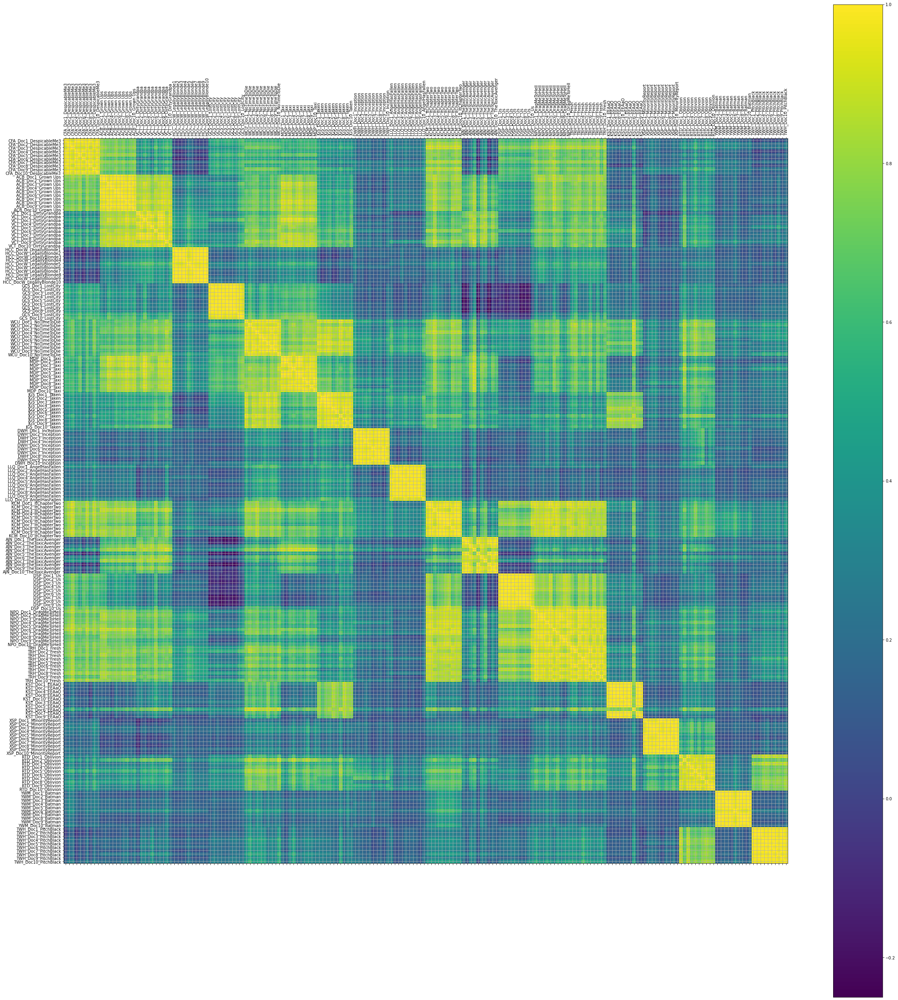

In [21]:
model_10topic_10words =plot_lsa(10, 10)

[(0, '-0.240*"character" + -0.165*"first" + -0.140*"action" + -0.136*"scene" + -0.135*"would" + -0.128*"thing" + -0.127*"movie" + -0.122*"year" + -0.107*"doesnt" + -0.107*"batman"'), (1, '0.604*"batman" + 0.239*"penguin" + 0.229*"burton" + 0.176*"return" + 0.168*"catwoman" + 0.161*"gotham" + 0.145*"shreck" + 0.145*"dream" + 0.108*"christopher" + 0.103*"villain"'), (2, '-0.240*"dream" + -0.195*"action" + -0.194*"inception" + 0.160*"batman" + -0.145*"anderton" + -0.138*"future" + 0.135*"comedy" + 0.134*"funny" + -0.132*"cruise" + -0.127*"spielberg"'), (3, '0.305*"dream" + 0.230*"inception" + 0.186*"fallen" + 0.183*"banning" + 0.182*"action" + -0.182*"black" + -0.164*"pitch" + -0.156*"planet" + -0.156*"alien" + -0.136*"riddick"'), (4, '0.366*"fallen" + 0.340*"banning" + -0.286*"dream" + 0.222*"angel" + -0.211*"inception" + 0.192*"president" + -0.127*"nolan" + 0.122*"butler" + -0.105*"blonde" + 0.104*"agent"'), (5, '0.208*"blonde" + 0.182*"witherspoon" + -0.177*"evelyn" + 0.168*"school" + 

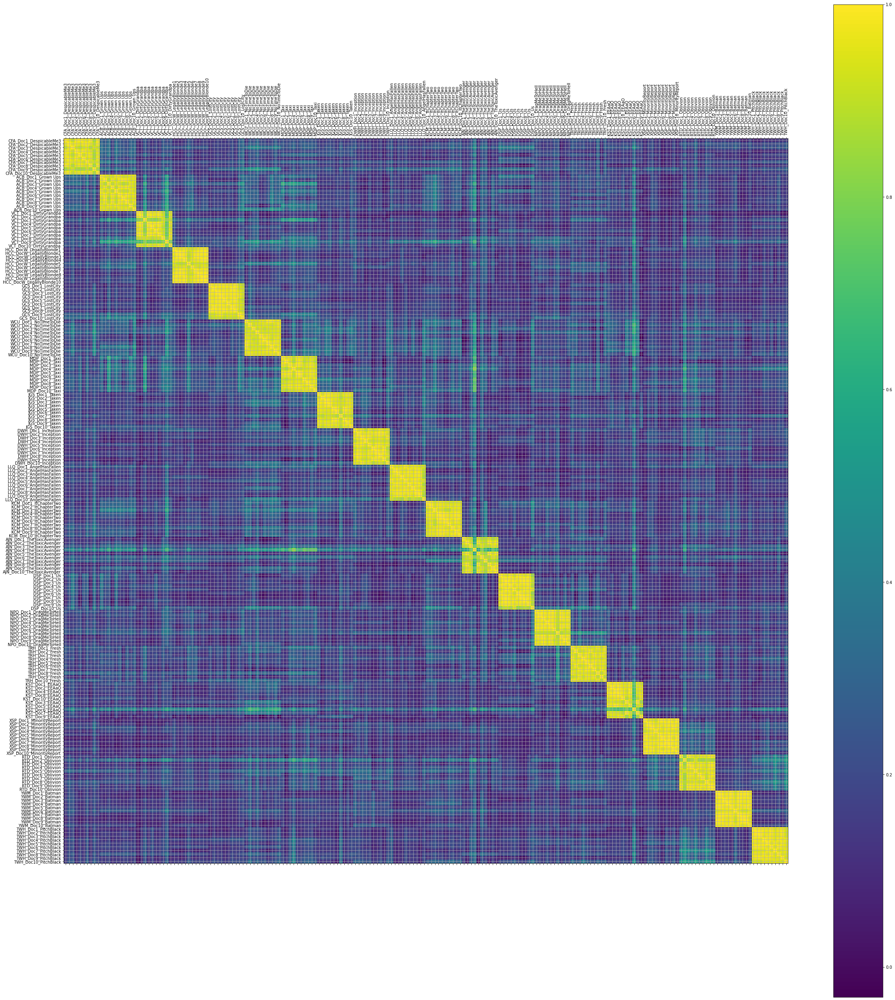

In [22]:
model_20topic_10words =plot_lsa(20, 10)

In [23]:
# Compare LSA model coherence

topics = [4, 5, 10, 20]
coherence_values = []
for t in topics:
    lsamodel,dictionary,index = create_gensim_lsa_model(processed_text,t,10)


    coherence_model_lsa = CoherenceModel(model=lsamodel, dictionary=dictionary, texts=processed_text, coherence='c_v')
    coherence_lsa = coherence_model_lsa.get_coherence()
    coherence_values.append(coherence_lsa)

    
coherence ={'4 topics 10 words':coherence_values[0],
            '5 topics 10 words': coherence_values[1],
            '10 topics 10 words':coherence_values[2],   
            '20 topics 10 words':coherence_values[3]} 
print(coherence)

[(0, '0.240*"character" + 0.165*"first" + 0.140*"action" + 0.136*"scene" + 0.135*"would" + 0.128*"thing" + 0.127*"movie" + 0.122*"year" + 0.107*"doesnt" + 0.107*"batman"'), (1, '0.604*"batman" + 0.239*"penguin" + 0.229*"burton" + 0.176*"return" + 0.168*"catwoman" + 0.161*"gotham" + 0.145*"shreck" + 0.145*"dream" + 0.108*"christopher" + 0.104*"villain"'), (2, '-0.240*"dream" + -0.194*"action" + -0.194*"inception" + 0.161*"batman" + -0.145*"anderton" + -0.138*"future" + 0.134*"funny" + 0.134*"comedy" + -0.132*"cruise" + -0.127*"spielberg"'), (3, '0.305*"dream" + 0.230*"inception" + 0.186*"fallen" + 0.183*"banning" + -0.182*"black" + 0.181*"action" + -0.165*"pitch" + -0.157*"planet" + -0.156*"alien" + -0.136*"riddick"')]


[(0, '0.240*"character" + 0.165*"first" + 0.140*"action" + 0.136*"scene" + 0.135*"would" + 0.128*"thing" + 0.127*"movie" + 0.122*"year" + 0.107*"doesnt" + 0.107*"batman"'), (1, '-0.604*"batman" + -0.238*"penguin" + -0.229*"burton" + -0.176*"return" + -0.168*"catwoman" + -0.161*"gotham" + -0.145*"shreck" + -0.145*"dream" + -0.108*"christopher" + -0.104*"villain"'), (2, '0.241*"dream" + 0.195*"action" + 0.194*"inception" + -0.161*"batman" + 0.145*"anderton" + 0.138*"future" + -0.134*"comedy" + -0.133*"funny" + 0.132*"cruise" + 0.127*"spielberg"'), (3, '-0.305*"dream" + -0.230*"inception" + -0.186*"fallen" + -0.183*"banning" + 0.182*"black" + -0.182*"action" + 0.165*"pitch" + 0.157*"alien" + 0.156*"planet" + 0.135*"riddick"'), (4, '-0.366*"fallen" + -0.341*"banning" + 0.285*"dream" + -0.222*"angel" + 0.211*"inception" + -0.192*"president" + 0.126*"nolan" + -0.123*"butler" + 0.105*"blonde" + -0.104*"agent"')]


[(0, '-0.240*"character" + -0.165*"first" + -0.140*"action" + -0.136*"scene" + -0.135*"would" + -0.128*"thing" + -0.127*"movie" + -0.122*"year" + -0.107*"doesnt" + -0.107*"batman"'), (1, '0.604*"batman" + 0.239*"penguin" + 0.229*"burton" + 0.176*"return" + 0.169*"catwoman" + 0.161*"gotham" + 0.145*"shreck" + 0.145*"dream" + 0.108*"christopher" + 0.104*"villain"'), (2, '-0.241*"dream" + -0.194*"action" + -0.194*"inception" + 0.160*"batman" + -0.145*"anderton" + -0.138*"future" + 0.135*"funny" + 0.134*"comedy" + -0.132*"cruise" + -0.127*"spielberg"'), (3, '-0.305*"dream" + -0.230*"inception" + -0.186*"fallen" + -0.183*"banning" + 0.182*"black" + -0.182*"action" + 0.165*"pitch" + 0.156*"alien" + 0.156*"planet" + 0.136*"riddick"'), (4, '-0.366*"fallen" + -0.340*"banning" + 0.285*"dream" + -0.222*"angel" + 0.211*"inception" + -0.192*"president" + 0.126*"nolan" + -0.123*"butler" + 0.105*"blonde" + -0.104*"agent"'), (5, '0.208*"blonde" + 0.182*"witherspoon" + -0.176*"evelyn" + 0.168*"school" 

[(0, '-0.240*"character" + -0.165*"first" + -0.140*"action" + -0.136*"scene" + -0.135*"would" + -0.128*"thing" + -0.127*"movie" + -0.122*"year" + -0.107*"doesnt" + -0.107*"batman"'), (1, '-0.603*"batman" + -0.239*"penguin" + -0.229*"burton" + -0.176*"return" + -0.168*"catwoman" + -0.161*"gotham" + -0.145*"shreck" + -0.145*"dream" + -0.108*"christopher" + -0.103*"villain"'), (2, '-0.241*"dream" + -0.194*"action" + -0.193*"inception" + 0.160*"batman" + -0.144*"anderton" + -0.138*"future" + 0.134*"funny" + 0.134*"comedy" + -0.132*"cruise" + -0.127*"spielberg"'), (3, '-0.305*"dream" + -0.229*"inception" + -0.186*"fallen" + -0.183*"banning" + 0.182*"black" + -0.182*"action" + 0.165*"pitch" + 0.156*"alien" + 0.156*"planet" + 0.136*"riddick"'), (4, '-0.366*"fallen" + -0.340*"banning" + 0.285*"dream" + -0.222*"angel" + 0.211*"inception" + -0.192*"president" + 0.126*"nolan" + -0.122*"butler" + 0.105*"blonde" + -0.105*"agent"'), (5, '0.208*"blonde" + 0.183*"witherspoon" + -0.176*"evelyn" + 0.168

## Latent Dirichlet Allocation (LDA) Analysis - Research Number of Topics and Number of Words

In [24]:
######################################
#EXPERIMENT WITH THESE PARAMETERS
number_of_topics=4
words=10
#####################################

[(0, '0.003*"would" + 0.003*"character" + 0.003*"movie" + 0.002*"scene" + 0.002*"doesnt" + 0.002*"first" + 0.002*"batman" + 0.002*"year" + 0.002*"comedy" + 0.002*"never"'), (1, '0.005*"character" + 0.003*"family" + 0.003*"year" + 0.003*"action" + 0.003*"first" + 0.002*"jason" + 0.002*"thing" + 0.002*"point" + 0.002*"grandpa" + 0.002*"fallen"'), (2, '0.004*"character" + 0.003*"first" + 0.003*"thing" + 0.003*"horror" + 0.003*"action" + 0.002*"dream" + 0.002*"movie" + 0.002*"there" + 0.002*"batman" + 0.002*"year"'), (3, '0.005*"character" + 0.004*"first" + 0.003*"scene" + 0.003*"action" + 0.002*"funny" + 0.002*"thats" + 0.002*"horror" + 0.002*"thing" + 0.002*"every" + 0.002*"there"')]


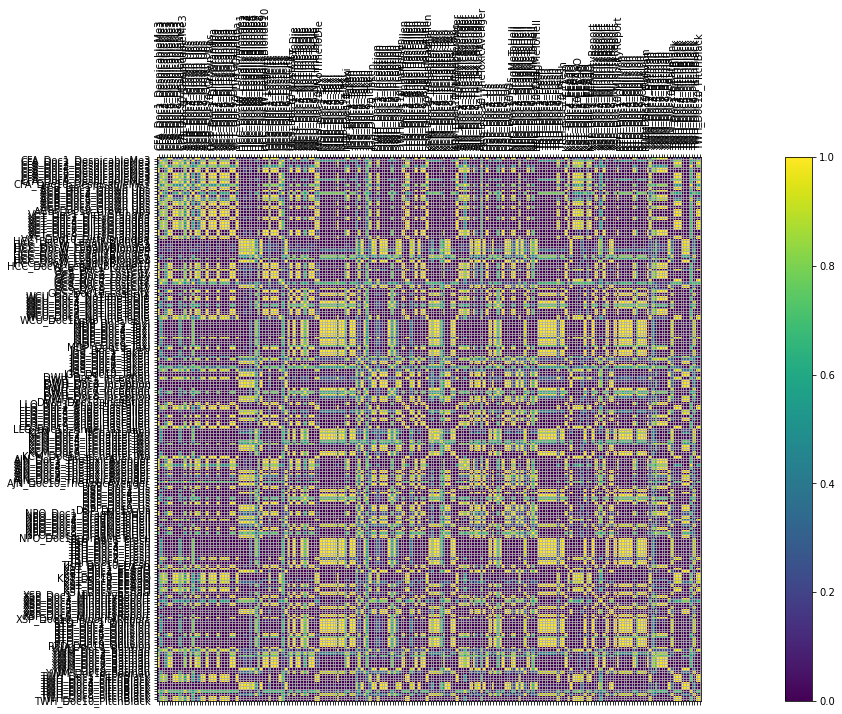

In [25]:
model2,dictionary2,index2,doctermmatrix2=create_gensim_lda_model( processed_text,number_of_topics,words, 200)

for doc in processed_text:
    vec_bow2 = dictionary2.doc2bow(doc)
    vec2 = model2[vec_bow2]  # convert the query to embedded space
    sims2 = index2[vec2]  # perform a similarity query against the corpus
    # print(list(enumerate(sims2)))  

fig, ax = plt.subplots(figsize=(30, 10))
cax = ax.matshow(index2, interpolation='nearest')
ax.grid(True)
plt.xticks(range(len(processed_text)), titles, rotation=90);
plt.yticks(range(len(processed_text)), titles);
fig.colorbar(cax)
plt.show()

[(0, '0.004*"character" + 0.003*"would" + 0.002*"dream" + 0.002*"thing" + 0.002*"black" + 0.002*"year" + 0.002*"family" + 0.002*"comedy" + 0.002*"action" + 0.002*"james"'), (1, '0.005*"character" + 0.003*"first" + 0.003*"funny" + 0.003*"scene" + 0.003*"there" + 0.003*"woman" + 0.002*"little" + 0.002*"thing" + 0.002*"would" + 0.002*"another"'), (2, '0.003*"thing" + 0.003*"first" + 0.003*"character" + 0.003*"scene" + 0.003*"would" + 0.002*"family" + 0.002*"year" + 0.002*"movie" + 0.002*"action" + 0.002*"really"'), (3, '0.004*"batman" + 0.004*"character" + 0.003*"first" + 0.003*"movie" + 0.003*"action" + 0.003*"horror" + 0.003*"still" + 0.003*"thing" + 0.002*"would" + 0.002*"scene"'), (4, '0.003*"character" + 0.003*"fallen" + 0.003*"dream" + 0.003*"action" + 0.003*"evelyn" + 0.003*"scene" + 0.002*"movie" + 0.002*"everything" + 0.002*"world" + 0.002*"banning"')]


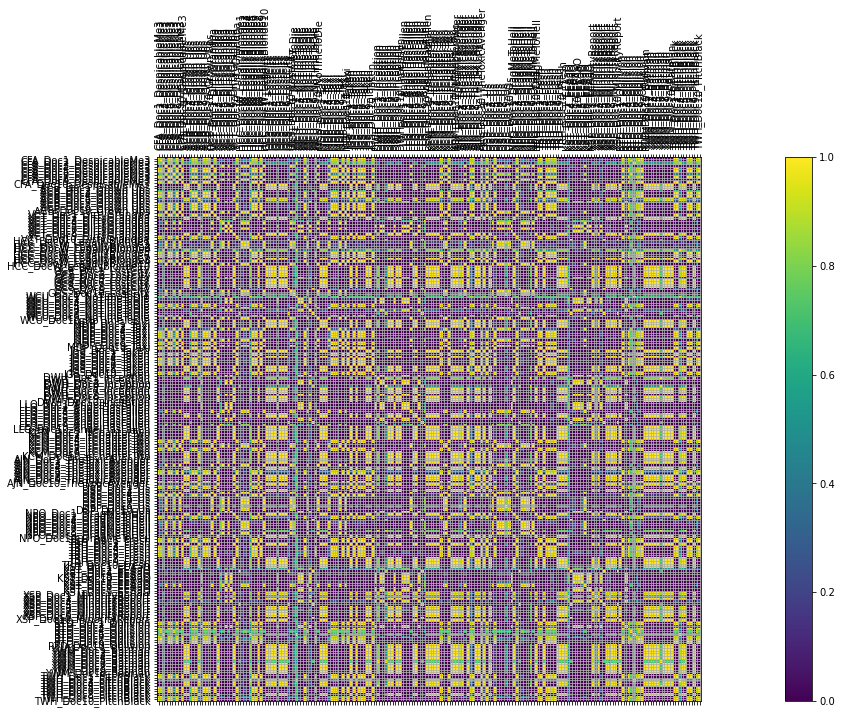

In [26]:
######################################
#EXPERIMENT WITH THESE PARAMETERS
number_of_topics=5
words=10
#####################################

model2,dictionary2,index2,doctermmatrix2=create_gensim_lda_model( processed_text,number_of_topics,words, 200)

for doc in processed_text:
    vec_bow2 = dictionary2.doc2bow(doc)
    vec2 = model2[vec_bow2]  # convert the query to embedded space
    sims2 = index2[vec2]  # perform a similarity query against the corpus
    # print(list(enumerate(sims2)))  

fig, ax = plt.subplots(figsize=(30, 10))
cax = ax.matshow(index2, interpolation='nearest')
ax.grid(True)
plt.xticks(range(len(processed_text)), titles, rotation=90);
plt.yticks(range(len(processed_text)), titles);
fig.colorbar(cax)
plt.show()

[(0, '0.007*"batman" + 0.004*"character" + 0.003*"penguin" + 0.003*"would" + 0.003*"going" + 0.003*"action" + 0.003*"first" + 0.003*"dream" + 0.003*"year" + 0.003*"movie"'), (1, '0.006*"character" + 0.004*"thing" + 0.003*"banning" + 0.003*"scene" + 0.003*"still" + 0.003*"action" + 0.003*"funny" + 0.003*"there" + 0.003*"future" + 0.002*"bullock"'), (2, '0.005*"would" + 0.005*"character" + 0.005*"family" + 0.003*"despicable" + 0.003*"scene" + 0.003*"year" + 0.003*"first" + 0.003*"world" + 0.003*"action" + 0.003*"funny"'), (3, '0.005*"batman" + 0.003*"character" + 0.003*"year" + 0.003*"thing" + 0.002*"together" + 0.002*"scene" + 0.002*"family" + 0.002*"movie" + 0.002*"going" + 0.002*"director"'), (4, '0.005*"character" + 0.005*"horror" + 0.004*"toxic" + 0.004*"comedy" + 0.003*"blonde" + 0.003*"woman" + 0.003*"first" + 0.003*"point" + 0.002*"movie" + 0.002*"thing"'), (5, '0.004*"first" + 0.003*"character" + 0.003*"daniel" + 0.003*"doesnt" + 0.003*"everything" + 0.003*"everywhere" + 0.003*"

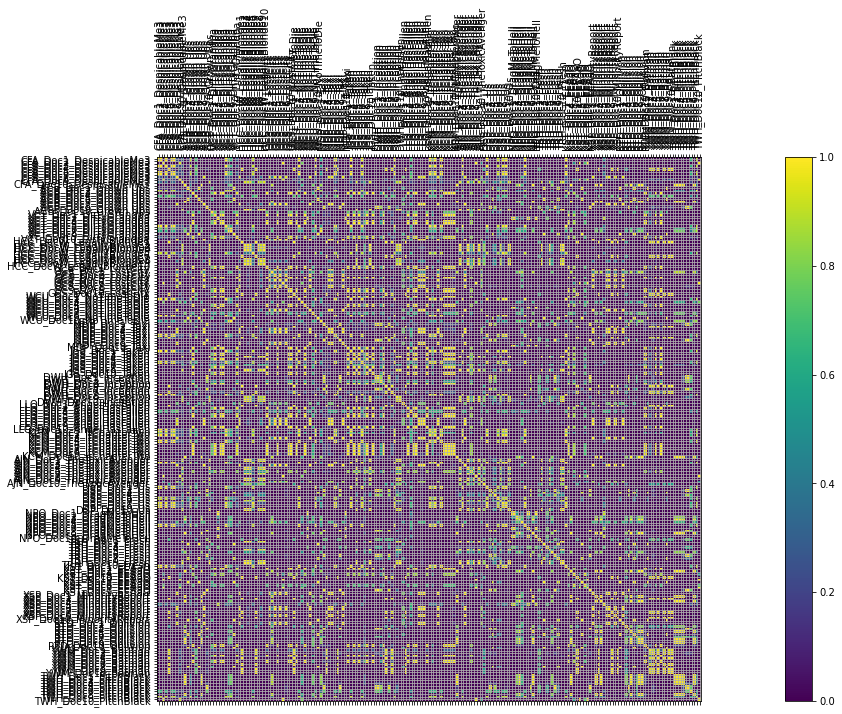

In [27]:
######################################
#EXPERIMENT WITH THESE PARAMETERS
number_of_topics=10
words=10
#####################################

model2,dictionary2,index2,doctermmatrix2=create_gensim_lda_model( processed_text,number_of_topics,words, 200)

for doc in processed_text:
    vec_bow2 = dictionary2.doc2bow(doc)
    vec2 = model2[vec_bow2]  # convert the query to embedded space
    sims2 = index2[vec2]  # perform a similarity query against the corpus
    # print(list(enumerate(sims2)))  

fig, ax = plt.subplots(figsize=(30, 10))
cax = ax.matshow(index2, interpolation='nearest')
ax.grid(True)
plt.xticks(range(len(processed_text)), titles, rotation=90);
plt.yticks(range(len(processed_text)), titles);
fig.colorbar(cax)
plt.show()

[(0, '0.006*"character" + 0.004*"dream" + 0.003*"movie" + 0.003*"scene" + 0.003*"first" + 0.003*"doesnt" + 0.003*"could" + 0.003*"oblivion" + 0.003*"steve" + 0.002*"woman"'), (1, '0.006*"character" + 0.005*"first" + 0.004*"family" + 0.004*"horror" + 0.003*"never" + 0.003*"dream" + 0.003*"bryan" + 0.003*"daughter" + 0.003*"three" + 0.003*"batman"'), (2, '0.004*"funny" + 0.004*"first" + 0.003*"thing" + 0.003*"character" + 0.003*"murder" + 0.003*"point" + 0.003*"great" + 0.003*"anderton" + 0.003*"would" + 0.003*"every"'), (3, '0.009*"bryan" + 0.006*"paris" + 0.005*"neeson" + 0.005*"daughter" + 0.004*"taken" + 0.004*"world" + 0.003*"besson" + 0.003*"friend" + 0.003*"action" + 0.003*"parent"'), (4, '0.006*"batman" + 0.004*"action" + 0.004*"taken" + 0.004*"character" + 0.003*"woman" + 0.003*"thing" + 0.003*"would" + 0.003*"christine" + 0.003*"first" + 0.002*"movie"'), (5, '0.006*"character" + 0.005*"evelyn" + 0.004*"scene" + 0.004*"everything" + 0.003*"waymond" + 0.003*"movie" + 0.003*"loret

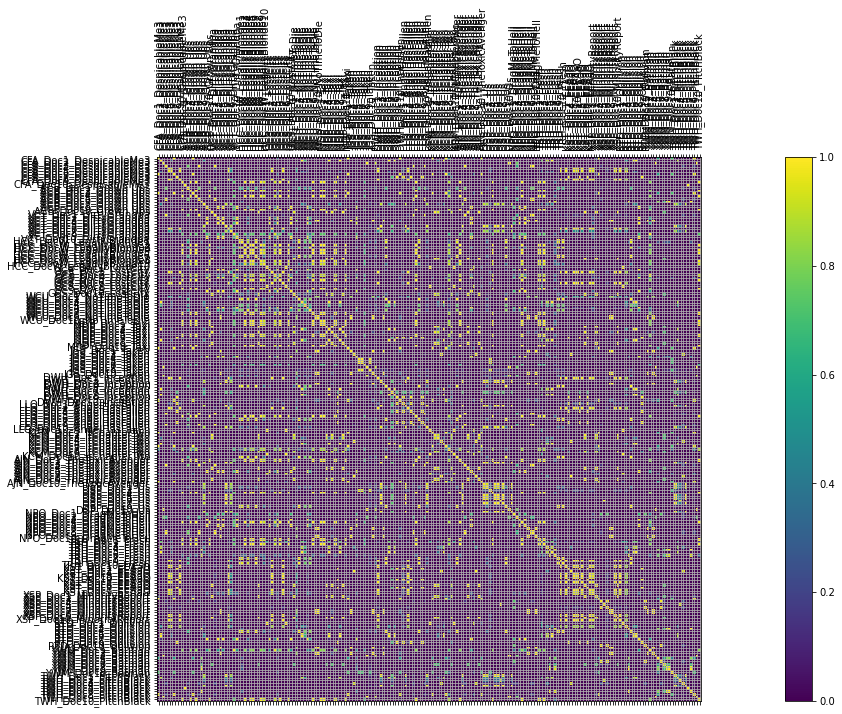

In [28]:
######################################
#EXPERIMENT WITH THESE PARAMETERS
number_of_topics=20
words=10
#####################################

model2,dictionary2,index2,doctermmatrix2=create_gensim_lda_model( processed_text,number_of_topics,words, 200)

for doc in processed_text:
    vec_bow2 = dictionary2.doc2bow(doc)
    vec2 = model2[vec_bow2]  # convert the query to embedded space
    sims2 = index2[vec2]  # perform a similarity query against the corpus
    # print(list(enumerate(sims2)))  

fig, ax = plt.subplots(figsize=(30, 10))
cax = ax.matshow(index2, interpolation='nearest')
ax.grid(True)
plt.xticks(range(len(processed_text)), titles, rotation=90);
plt.yticks(range(len(processed_text)), titles);
fig.colorbar(cax)
plt.show()

In [29]:
# compare LDA model coherence

topics = [4, 5, 10, 20]
coherence_values = []
for t in topics:
    ldamodel,dictionary,index, matrix = create_gensim_lda_model(processed_text,t,10, 200)


    coherence_model_lda = CoherenceModel(model=ldamodel, dictionary=dictionary, texts=processed_text, coherence='c_v')
    coherence_lda = coherence_model_lda.get_coherence()
    coherence_values.append(coherence_lda)

    
coherence ={'4 topics 10 words':coherence_values[0],
            '5 topics 10 words': coherence_values[1],
            '10 topics 10 words':coherence_values[2],   
            '20 topics 10 words':coherence_values[3]} 
print(coherence)

[(0, '0.003*"character" + 0.003*"first" + 0.003*"scene" + 0.002*"horror" + 0.002*"year" + 0.002*"woman" + 0.002*"james" + 0.002*"would" + 0.002*"action" + 0.002*"three"'), (1, '0.005*"character" + 0.003*"first" + 0.003*"would" + 0.003*"doesnt" + 0.003*"movie" + 0.003*"family" + 0.003*"year" + 0.002*"thing" + 0.002*"horror" + 0.002*"comedy"'), (2, '0.004*"character" + 0.004*"action" + 0.003*"scene" + 0.003*"thing" + 0.003*"woman" + 0.002*"first" + 0.002*"would" + 0.002*"funny" + 0.002*"fallen" + 0.002*"year"'), (3, '0.004*"batman" + 0.003*"character" + 0.003*"first" + 0.002*"thing" + 0.002*"little" + 0.002*"scene" + 0.002*"movie" + 0.002*"dream" + 0.002*"would" + 0.002*"people"')]


[(0, '0.003*"first" + 0.003*"action" + 0.002*"character" + 0.002*"movie" + 0.002*"future" + 0.002*"going" + 0.002*"doesnt" + 0.002*"would" + 0.002*"director" + 0.002*"never"'), (1, '0.005*"character" + 0.004*"batman" + 0.004*"action" + 0.004*"dream" + 0.004*"first" + 0.003*"thing" + 0.003*"scene" + 0.003*"movie" + 0.002*"would" + 0.002*"world"'), (2, '0.005*"character" + 0.003*"year" + 0.003*"family" + 0.003*"would" + 0.003*"thing" + 0.003*"scene" + 0.003*"first" + 0.003*"horror" + 0.003*"funny" + 0.002*"doesnt"'), (3, '0.003*"character" + 0.003*"doesnt" + 0.003*"toxic" + 0.002*"everything" + 0.002*"movie" + 0.002*"woman" + 0.002*"oblivion" + 0.002*"daniel" + 0.002*"always" + 0.002*"cruise"'), (4, '0.004*"character" + 0.004*"first" + 0.003*"horror" + 0.003*"scene" + 0.003*"year" + 0.003*"would" + 0.002*"family" + 0.002*"woman" + 0.002*"action" + 0.002*"funny"')]


[(0, '0.005*"batman" + 0.005*"family" + 0.004*"peele" + 0.003*"penguin" + 0.003*"sandler" + 0.003*"little" + 0.003*"friend" + 0.003*"movie" + 0.003*"jason" + 0.002*"grandpa"'), (1, '0.004*"character" + 0.003*"first" + 0.003*"thing" + 0.003*"scene" + 0.003*"christine" + 0.003*"woman" + 0.002*"alien" + 0.002*"something" + 0.002*"there" + 0.002*"played"'), (2, '0.003*"character" + 0.003*"daniel" + 0.003*"doesnt" + 0.003*"scene" + 0.003*"woman" + 0.003*"batman" + 0.002*"year" + 0.002*"thing" + 0.002*"family" + 0.002*"series"'), (3, '0.005*"character" + 0.004*"family" + 0.004*"would" + 0.004*"year" + 0.003*"first" + 0.003*"movie" + 0.003*"funny" + 0.003*"batman" + 0.003*"point" + 0.003*"despicable"'), (4, '0.005*"first" + 0.004*"dream" + 0.004*"character" + 0.003*"would" + 0.003*"horror" + 0.003*"inception" + 0.003*"doesnt" + 0.003*"movie" + 0.002*"year" + 0.002*"going"'), (5, '0.003*"character" + 0.003*"first" + 0.002*"thing" + 0.002*"family" + 0.002*"point" + 0.002*"brother" + 0.002*"neve

[(0, '0.004*"character" + 0.003*"scene" + 0.003*"doesnt" + 0.003*"fallen" + 0.003*"toxic" + 0.003*"would" + 0.003*"steve" + 0.002*"angel" + 0.002*"first" + 0.002*"never"'), (1, '0.005*"year" + 0.005*"character" + 0.004*"funny" + 0.004*"bullock" + 0.004*"family" + 0.003*"every" + 0.003*"bryan" + 0.003*"tatum" + 0.003*"laugh" + 0.003*"thats"'), (2, '0.005*"batman" + 0.004*"character" + 0.004*"every" + 0.003*"going" + 0.003*"penguin" + 0.003*"action" + 0.003*"played" + 0.003*"dream" + 0.003*"around" + 0.003*"make"'), (3, '0.004*"thing" + 0.004*"raimi" + 0.004*"despicable" + 0.003*"there" + 0.003*"family" + 0.003*"taken" + 0.003*"horror" + 0.003*"daughter" + 0.003*"neeson" + 0.002*"brother"'), (4, '0.007*"taken" + 0.005*"character" + 0.004*"neeson" + 0.004*"bryan" + 0.004*"action" + 0.004*"first" + 0.003*"people" + 0.003*"dream" + 0.003*"daughter" + 0.003*"tatum"'), (5, '0.006*"loretta" + 0.006*"character" + 0.004*"year" + 0.004*"first" + 0.004*"scene" + 0.003*"would" + 0.003*"really" + 0.

## Cluster Model Research: KMeans, SVM, Logistic, Naive Bayes, Random Forest

<div class="alert alert-block alert-success">
    <b>sklearn.cluster.KMeans</b>:<br> 
https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html<br><br>
<b>KMeans Default Parameters</b>:<br>
    class sklearn.cluster.KMeans(n_clusters=8, *, init='k-means++', n_init=10, max_iter=300, tol=0.0001, verbose=0, random_state=None, copy_x=True, algorithm='auto')
    </div>

### Explore K-means clustering of TFIDF matrix

In [30]:
tfidf_matrix, tfidf_words = tfidf(final_processed_text, titles, ngram_range = (1,1))
#tfidf_matrix

### Implementation of Silhouette Score - optimal number of clusters

In [31]:
k_list = [2, 3, 4, 5, 7, 9 ,11, 13, 15, 17, 19, 20, 21]

k_scores=[]

for k in k_list:
    km = KMeans(n_clusters=k, random_state =89)
    km.fit(tfidf_matrix)
    labels = km.labels_.tolist()
    score = silhouette_score(tfidf_matrix, labels)
    k_scores.append(score)
    print(f'k={k}, Silhouette Score: %.3f' % score)  

k=2, Silhouette Score: 0.011
k=3, Silhouette Score: 0.014
k=4, Silhouette Score: 0.017
k=5, Silhouette Score: 0.017
k=7, Silhouette Score: 0.033
k=9, Silhouette Score: 0.038
k=11, Silhouette Score: 0.043
k=13, Silhouette Score: 0.056
k=15, Silhouette Score: 0.066
k=17, Silhouette Score: 0.076
k=19, Silhouette Score: 0.085
k=20, Silhouette Score: 0.088
k=21, Silhouette Score: 0.084


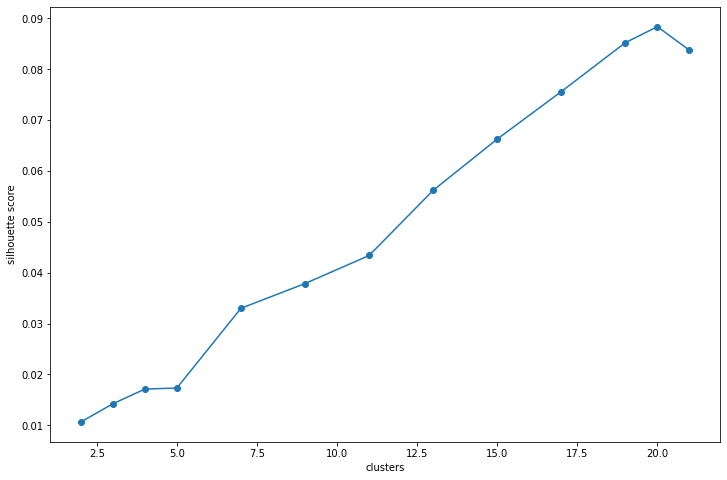

In [32]:
plt.figure(figsize=(12, 8))
plt.scatter(k_list, k_scores)
plt.plot(k_list, k_scores)
plt.xlabel("clusters")
plt.ylabel("silhouette score")
plt.show()

Explore K-means clustering of TFIDF matrix

In [33]:
mds = MDS(n_components=2, dissimilarity="precomputed", random_state=5)

In [34]:
cluster_title, clusters, k_means_df = k_means(titles, tfidf_matrix, k =2)
cluster_title

{0: ['WCU_Doc1_NoTimeToDie',
  'WCU_Doc5_NoTimeToDie',
  'WCU_Doc7_NoTimeToDie',
  'JGS_Doc2_Taken',
  'JGS_Doc7_Taken',
  'JGS_Doc9_Taken',
  'DWH_Doc1_Inception',
  'DWH_Doc2_Inception',
  'DWH_Doc3_Inception',
  'DWH_Doc4_Inception',
  'DWH_Doc5_Inception',
  'DWH_Doc6_Inception',
  'DWH_Doc7_Inception',
  'DWH_Doc8_Inception',
  'DWH_Doc9_Inception',
  'DWH_Doc10_Inception',
  'LLQ_Doc1_AngelHasFallen',
  'LLQ_Doc2_AngelHasFallen',
  'LLQ_Doc3_AngelHasFallen',
  'LLQ_Doc4_AngelHasFallen',
  'LLQ_Doc5_AngelHasFallen',
  'LLQ_Doc6_AngelHasFallen',
  'LLQ_Doc7_AngelHasFallen',
  'LLQ_Doc8_AngelHasFallen',
  'LLQ_Doc9_AngelHasFallen',
  'LLQ_Doc10_AngelHasFallen',
  'XSP_Doc1_MinorityReport',
  'XSP_Doc2_MinorityReport',
  'XSP_Doc3_MinorityReport',
  'XSP_Doc4_MinorityReport',
  'XSP_Doc5_MinorityReport',
  'XSP_Doc6_MinorityReport',
  'XSP_Doc7_MinorityReport',
  'XSP_Doc8_MinorityReport',
  'XSP_Doc9_MinorityReport',
  'XSP_Doc10_MinorityReport',
  'RTD_Doc1_Oblivion',
  'RTD_Doc3_O

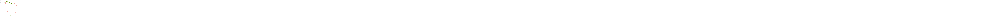

In [35]:
plot_tfidf_matrix(cluster_title,clusters,tfidf_matrix)

In [36]:
k_means_tfidf(tfidf_matrix,terms,titles,final_processed_text, k=2)


Top terms per cluster:
Cluster 0:
 batman
 dream
 fallen
 banning
 inception
 action
 planet
 cruise
 oblivion
 anderton
Cluster 0 titles: WCU_Doc1_NoTimeToDie, WCU_Doc5_NoTimeToDie, WCU_Doc7_NoTimeToDie, JGS_Doc2_Taken, JGS_Doc7_Taken, JGS_Doc9_Taken, DWH_Doc1_Inception, DWH_Doc2_Inception, DWH_Doc3_Inception, DWH_Doc4_Inception, DWH_Doc5_Inception, DWH_Doc6_Inception, DWH_Doc7_Inception, DWH_Doc8_Inception, DWH_Doc9_Inception, DWH_Doc10_Inception, LLQ_Doc1_AngelHasFallen, LLQ_Doc2_AngelHasFallen, LLQ_Doc3_AngelHasFallen, LLQ_Doc4_AngelHasFallen, LLQ_Doc5_AngelHasFallen, LLQ_Doc6_AngelHasFallen, LLQ_Doc7_AngelHasFallen, LLQ_Doc8_AngelHasFallen, LLQ_Doc9_AngelHasFallen, LLQ_Doc10_AngelHasFallen, XSP_Doc1_MinorityReport, XSP_Doc2_MinorityReport, XSP_Doc3_MinorityReport, XSP_Doc4_MinorityReport, XSP_Doc5_MinorityReport, XSP_Doc6_MinorityReport, XSP_Doc7_MinorityReport, XSP_Doc8_MinorityReport, XSP_Doc9_MinorityReport, XSP_Doc10_MinorityReport, RTD_Doc1_Oblivion, RTD_Doc3_Oblivion, RTD_Do

In [37]:
# plot_tfidf_matrix(cluster_title,clusters,tfidf_matrix)

In [38]:
cluster_title, clusters, k_means_df = k_means(titles, tfidf_matrix, k =4)
cluster_title

{0: ['CFA_Doc1_DespicableMe3',
  'CFA_Doc4_DespicableMe3',
  'CFA_Doc5_DespicableMe3',
  'CFA_Doc7_DespicableMe3',
  'CFA_Doc8_DespicableMe3',
  'CFA_Doc9_DespicableMe3',
  'CFA_Doc10_DespicableMe3',
  'ACB_Doc1_Grown Ups',
  'ACB_Doc2_Grown Ups',
  'ACB_Doc3_Grown Ups',
  'ACB_Doc4_Grown Ups',
  'ACB_Doc5_Grown Ups',
  'ACB_Doc6_Grown Ups',
  'ACB_Doc7_Grown Ups',
  'ACB_Doc8_Grown Ups',
  'ACB_Doc9_Grown Ups',
  'ACB_Doc10_Grown Ups',
  'VCT_Doc1_DirtyGrandpa',
  'VCT_Doc2_DirtyGrandpa',
  'VCT_Doc3_DirtyGrandpa',
  'VCT_Doc4_DirtyGrandpa',
  'VCT_Doc5_DirtyGrandpa',
  'VCT_Doc6_DirtyGrandpa',
  'VCT_Doc7_DirtyGrandpa',
  'VCT_Doc8_DirtyGrandpa',
  'VCT_Doc9_DirtyGrandpa',
  'VCT_Doc10_DirtyGrandpa',
  'HCC_DocW_LegallyBlonde1',
  'HCC_DocW_LegallyBlonde2',
  'HCC_DocW_LegallyBlonde3',
  'HCC_DocW_LegallyBlonde4',
  'HCC_DocW_LegallyBlonde5',
  'HCC_DocW_LegallyBlonde6',
  'HCC_DocW_LegallyBlonde7',
  'HCC_DocW_LegallyBlonde8',
  'HCC_DocW_LegallyBlonde9',
  'HCC_DocW_LegallyBlonde10

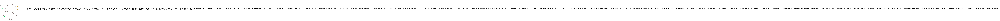

In [39]:
plot_tfidf_matrix(cluster_title,clusters,tfidf_matrix)

In [40]:
k_means_tfidf(tfidf_matrix,terms,titles,final_processed_text, k=4)


Top terms per cluster:
Cluster 0:
 funny
 toxic
 fallen
 comedy
 character
 banning
 loretta
 grandpa
 thing
 would
Cluster 0 titles: CFA_Doc1_DespicableMe3, CFA_Doc4_DespicableMe3, CFA_Doc5_DespicableMe3, CFA_Doc7_DespicableMe3, CFA_Doc8_DespicableMe3, CFA_Doc9_DespicableMe3, CFA_Doc10_DespicableMe3, ACB_Doc1_Grown Ups, ACB_Doc2_Grown Ups, ACB_Doc3_Grown Ups, ACB_Doc4_Grown Ups, ACB_Doc5_Grown Ups, ACB_Doc6_Grown Ups, ACB_Doc7_Grown Ups, ACB_Doc8_Grown Ups, ACB_Doc9_Grown Ups, ACB_Doc10_Grown Ups, VCT_Doc1_DirtyGrandpa, VCT_Doc2_DirtyGrandpa, VCT_Doc3_DirtyGrandpa, VCT_Doc4_DirtyGrandpa, VCT_Doc5_DirtyGrandpa, VCT_Doc6_DirtyGrandpa, VCT_Doc7_DirtyGrandpa, VCT_Doc8_DirtyGrandpa, VCT_Doc9_DirtyGrandpa, VCT_Doc10_DirtyGrandpa, HCC_DocW_LegallyBlonde1, HCC_DocW_LegallyBlonde2, HCC_DocW_LegallyBlonde3, HCC_DocW_LegallyBlonde4, HCC_DocW_LegallyBlonde5, HCC_DocW_LegallyBlonde6, HCC_DocW_LegallyBlonde7, HCC_DocW_LegallyBlonde8, HCC_DocW_LegallyBlonde9, HCC_DocW_LegallyBlonde10, GCS_Doc1_LostC

In [41]:
cluster_title, clusters, k_means_df = k_means(titles, tfidf_matrix, k =17)
cluster_title

{0: ['YWM_Doc1_Batman',
  'YWM_Doc2_Batman',
  'YWM_Doc3_Batman',
  'YWM_Doc4_Batman',
  'YWM_Doc5_Batman',
  'YWM_Doc6_Batman',
  'YWM_Doc7_Batman',
  'YWM_Doc8_Batman',
  'YWM_Doc9_Batman',
  'YWM_Doc10_Batman'],
 1: ['GCS_Doc1_LostCity',
  'GCS_Doc2_LostCity',
  'GCS_Doc3_LostCity',
  'GCS_Doc4_LostCity',
  'GCS_Doc5_LostCity',
  'GCS_Doc6_LostCity',
  'GCS_Doc7_LostCity',
  'GCS_Doc8_LostCity',
  'GCS_Doc9_LostCity',
  'GCS_Doc10_LostCity'],
 2: ['LLQ_Doc1_AngelHasFallen',
  'LLQ_Doc2_AngelHasFallen',
  'LLQ_Doc3_AngelHasFallen',
  'LLQ_Doc4_AngelHasFallen',
  'LLQ_Doc5_AngelHasFallen',
  'LLQ_Doc6_AngelHasFallen',
  'LLQ_Doc7_AngelHasFallen',
  'LLQ_Doc8_AngelHasFallen',
  'LLQ_Doc9_AngelHasFallen',
  'LLQ_Doc10_AngelHasFallen'],
 3: ['TRH_Doc1_Fresh',
  'TRH_Doc2_Fresh',
  'TRH_Doc3_Fresh',
  'TRH_Doc4_Fresh',
  'TRH_Doc5_Fresh',
  'TRH_Doc6_Fresh',
  'TRH_Doc7_Fresh',
  'TRH_Doc8_Fresh',
  'TRH_Doc9_Fresh',
  'TRH_Doc10_Fresh'],
 4: ['TWH_Doc1_PitchBlack',
  'TWH_Doc2_PitchBlack

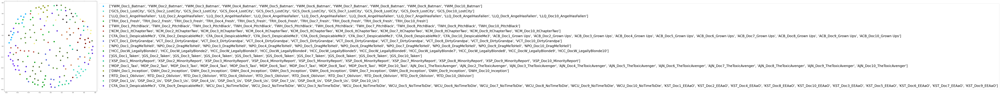

In [42]:
plot_tfidf_matrix(cluster_title,clusters,tfidf_matrix)

In [43]:
k_means_tfidf(tfidf_matrix,terms,titles,final_processed_text, k=17)


Top terms per cluster:
Cluster 0:
 batman
 penguin
 burton
 catwoman
 gotham
 shreck
 return
 keaton
 wayne
 walken
Cluster 0 titles: YWM_Doc1_Batman, YWM_Doc2_Batman, YWM_Doc3_Batman, YWM_Doc4_Batman, YWM_Doc5_Batman, YWM_Doc6_Batman, YWM_Doc7_Batman, YWM_Doc8_Batman, YWM_Doc9_Batman, YWM_Doc10_Batman,Cluster 1:
 loretta
 bullock
 tatum
 sandra
 treasure
 fairfax
 adventure
 stone
 channing
 book
Cluster 1 titles: GCS_Doc1_LostCity, GCS_Doc2_LostCity, GCS_Doc3_LostCity, GCS_Doc4_LostCity, GCS_Doc5_LostCity, GCS_Doc6_LostCity, GCS_Doc7_LostCity, GCS_Doc8_LostCity, GCS_Doc9_LostCity, GCS_Doc10_LostCity,Cluster 2:
 fallen
 banning
 angel
 president
 butler
 trumbull
 london
 service
 gerard
 freeman
Cluster 2 titles: LLQ_Doc1_AngelHasFallen, LLQ_Doc2_AngelHasFallen, LLQ_Doc3_AngelHasFallen, LLQ_Doc4_AngelHasFallen, LLQ_Doc5_AngelHasFallen, LLQ_Doc6_AngelHasFallen, LLQ_Doc7_AngelHasFallen, LLQ_Doc8_AngelHasFallen, LLQ_Doc9_AngelHasFallen, LLQ_Doc10_AngelHasFallen,Cluster 3:
 fresh
 steve


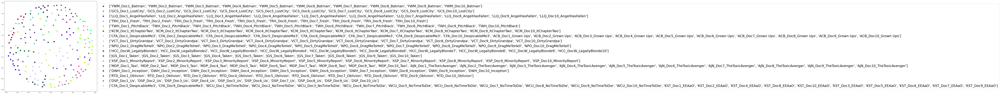

In [44]:
plot_tfidf_matrix(cluster_title,clusters,tfidf_matrix)

In [45]:
cluster_title, clusters, k_means_df = k_means(titles, tfidf_matrix, k =20)
cluster_title

{0: ['TRH_Doc1_Fresh',
  'TRH_Doc2_Fresh',
  'TRH_Doc3_Fresh',
  'TRH_Doc4_Fresh',
  'TRH_Doc5_Fresh',
  'TRH_Doc6_Fresh',
  'TRH_Doc7_Fresh',
  'TRH_Doc8_Fresh',
  'TRH_Doc9_Fresh',
  'TRH_Doc10_Fresh'],
 1: ['JGS_Doc1_Taken',
  'JGS_Doc2_Taken',
  'JGS_Doc3_Taken',
  'JGS_Doc4_Taken',
  'JGS_Doc5_Taken',
  'JGS_Doc6_Taken',
  'JGS_Doc7_Taken',
  'JGS_Doc8_Taken',
  'JGS_Doc9_Taken',
  'JGS_Doc10_Taken'],
 2: ['GCS_Doc1_LostCity',
  'GCS_Doc2_LostCity',
  'GCS_Doc3_LostCity',
  'GCS_Doc4_LostCity',
  'GCS_Doc5_LostCity',
  'GCS_Doc6_LostCity',
  'GCS_Doc7_LostCity',
  'GCS_Doc8_LostCity',
  'GCS_Doc9_LostCity',
  'GCS_Doc10_LostCity'],
 3: ['YWM_Doc1_Batman',
  'YWM_Doc2_Batman',
  'YWM_Doc3_Batman',
  'YWM_Doc4_Batman',
  'YWM_Doc5_Batman',
  'YWM_Doc6_Batman',
  'YWM_Doc7_Batman',
  'YWM_Doc8_Batman',
  'YWM_Doc9_Batman',
  'YWM_Doc10_Batman'],
 4: ['DWH_Doc1_Inception',
  'DWH_Doc2_Inception',
  'DWH_Doc3_Inception',
  'DWH_Doc4_Inception',
  'DWH_Doc5_Inception',
  'DWH_Doc6_Incep

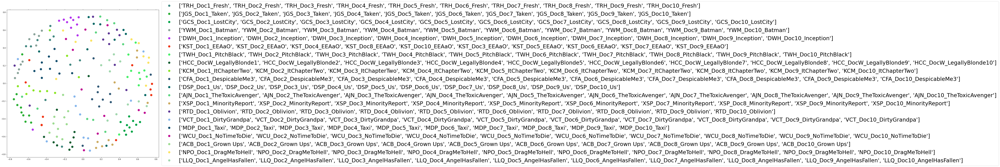

In [46]:
plot_tfidf_matrix(cluster_title,clusters,tfidf_matrix)

Top terms per cluster:
Cluster 0:
 fresh
 steve
 dating
 edgarjones
 woman
 mollie
 steves
 cave
 horror
 daisy
Cluster 0 titles: TRH_Doc1_Fresh, TRH_Doc2_Fresh, TRH_Doc3_Fresh, TRH_Doc4_Fresh, TRH_Doc5_Fresh, TRH_Doc6_Fresh, TRH_Doc7_Fresh, TRH_Doc8_Fresh, TRH_Doc9_Fresh, TRH_Doc10_Fresh,Cluster 1:
 bryan
 neeson
 taken
 paris
 daughter
 mill
 besson
 action
 janssen
 albanian
Cluster 1 titles: JGS_Doc1_Taken, JGS_Doc2_Taken, JGS_Doc3_Taken, JGS_Doc4_Taken, JGS_Doc5_Taken, JGS_Doc6_Taken, JGS_Doc7_Taken, JGS_Doc8_Taken, JGS_Doc9_Taken, JGS_Doc10_Taken,Cluster 2:
 loretta
 bullock
 tatum
 sandra
 treasure
 fairfax
 adventure
 stone
 channing
 book
Cluster 2 titles: GCS_Doc1_LostCity, GCS_Doc2_LostCity, GCS_Doc3_LostCity, GCS_Doc4_LostCity, GCS_Doc5_LostCity, GCS_Doc6_LostCity, GCS_Doc7_LostCity, GCS_Doc8_LostCity, GCS_Doc9_LostCity, GCS_Doc10_LostCity,Cluster 3:
 batman
 penguin
 burton
 catwoman
 gotham
 shreck
 return
 keaton
 wayne
 walken
Cluster 3 titles: YWM_Doc1_Batman, YWM_Doc2

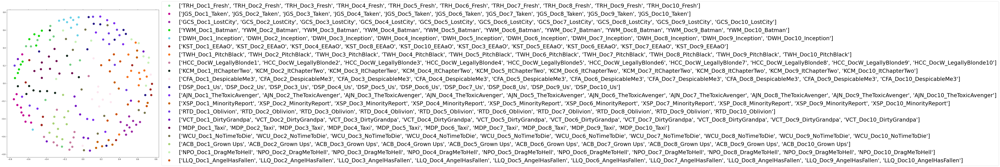

In [47]:
k_means_tfidf(tfidf_matrix,terms,titles,final_processed_text, k=20)
plot_tfidf_matrix(cluster_title,clusters,tfidf_matrix)

In [48]:
mds = MDS(n_components=2, dissimilarity="precomputed", random_state=10)

In [49]:
cluster_title, clusters, k_means_df = k_means(titles, tfidf_matrix, k =2)
cluster_title

{0: ['WCU_Doc1_NoTimeToDie',
  'WCU_Doc5_NoTimeToDie',
  'WCU_Doc7_NoTimeToDie',
  'JGS_Doc2_Taken',
  'JGS_Doc7_Taken',
  'JGS_Doc9_Taken',
  'DWH_Doc1_Inception',
  'DWH_Doc2_Inception',
  'DWH_Doc3_Inception',
  'DWH_Doc4_Inception',
  'DWH_Doc5_Inception',
  'DWH_Doc6_Inception',
  'DWH_Doc7_Inception',
  'DWH_Doc8_Inception',
  'DWH_Doc9_Inception',
  'DWH_Doc10_Inception',
  'LLQ_Doc1_AngelHasFallen',
  'LLQ_Doc2_AngelHasFallen',
  'LLQ_Doc3_AngelHasFallen',
  'LLQ_Doc4_AngelHasFallen',
  'LLQ_Doc5_AngelHasFallen',
  'LLQ_Doc6_AngelHasFallen',
  'LLQ_Doc7_AngelHasFallen',
  'LLQ_Doc8_AngelHasFallen',
  'LLQ_Doc9_AngelHasFallen',
  'LLQ_Doc10_AngelHasFallen',
  'XSP_Doc1_MinorityReport',
  'XSP_Doc2_MinorityReport',
  'XSP_Doc3_MinorityReport',
  'XSP_Doc4_MinorityReport',
  'XSP_Doc5_MinorityReport',
  'XSP_Doc6_MinorityReport',
  'XSP_Doc7_MinorityReport',
  'XSP_Doc8_MinorityReport',
  'XSP_Doc9_MinorityReport',
  'XSP_Doc10_MinorityReport',
  'RTD_Doc1_Oblivion',
  'RTD_Doc3_O

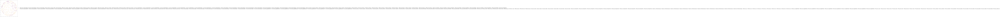

In [50]:
plot_tfidf_matrix(cluster_title,clusters,tfidf_matrix)

Top terms per cluster:
Cluster 0:
 batman
 dream
 fallen
 banning
 inception
 action
 planet
 cruise
 oblivion
 anderton
Cluster 0 titles: WCU_Doc1_NoTimeToDie, WCU_Doc5_NoTimeToDie, WCU_Doc7_NoTimeToDie, JGS_Doc2_Taken, JGS_Doc7_Taken, JGS_Doc9_Taken, DWH_Doc1_Inception, DWH_Doc2_Inception, DWH_Doc3_Inception, DWH_Doc4_Inception, DWH_Doc5_Inception, DWH_Doc6_Inception, DWH_Doc7_Inception, DWH_Doc8_Inception, DWH_Doc9_Inception, DWH_Doc10_Inception, LLQ_Doc1_AngelHasFallen, LLQ_Doc2_AngelHasFallen, LLQ_Doc3_AngelHasFallen, LLQ_Doc4_AngelHasFallen, LLQ_Doc5_AngelHasFallen, LLQ_Doc6_AngelHasFallen, LLQ_Doc7_AngelHasFallen, LLQ_Doc8_AngelHasFallen, LLQ_Doc9_AngelHasFallen, LLQ_Doc10_AngelHasFallen, XSP_Doc1_MinorityReport, XSP_Doc2_MinorityReport, XSP_Doc3_MinorityReport, XSP_Doc4_MinorityReport, XSP_Doc5_MinorityReport, XSP_Doc6_MinorityReport, XSP_Doc7_MinorityReport, XSP_Doc8_MinorityReport, XSP_Doc9_MinorityReport, XSP_Doc10_MinorityReport, RTD_Doc1_Oblivion, RTD_Doc3_Oblivion, RTD_Do

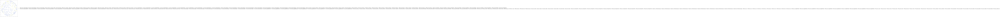

In [51]:
k_means_tfidf(tfidf_matrix,terms,titles,final_processed_text, k=2)
plot_tfidf_matrix(cluster_title,clusters,tfidf_matrix)

In [52]:
cluster_title, clusters, k_means_df = k_means(titles, tfidf_matrix, k =4)
cluster_title

{0: ['CFA_Doc1_DespicableMe3',
  'CFA_Doc4_DespicableMe3',
  'CFA_Doc5_DespicableMe3',
  'CFA_Doc7_DespicableMe3',
  'CFA_Doc8_DespicableMe3',
  'CFA_Doc9_DespicableMe3',
  'CFA_Doc10_DespicableMe3',
  'ACB_Doc1_Grown Ups',
  'ACB_Doc2_Grown Ups',
  'ACB_Doc3_Grown Ups',
  'ACB_Doc4_Grown Ups',
  'ACB_Doc5_Grown Ups',
  'ACB_Doc6_Grown Ups',
  'ACB_Doc7_Grown Ups',
  'ACB_Doc8_Grown Ups',
  'ACB_Doc9_Grown Ups',
  'ACB_Doc10_Grown Ups',
  'VCT_Doc1_DirtyGrandpa',
  'VCT_Doc2_DirtyGrandpa',
  'VCT_Doc3_DirtyGrandpa',
  'VCT_Doc4_DirtyGrandpa',
  'VCT_Doc5_DirtyGrandpa',
  'VCT_Doc6_DirtyGrandpa',
  'VCT_Doc7_DirtyGrandpa',
  'VCT_Doc8_DirtyGrandpa',
  'VCT_Doc9_DirtyGrandpa',
  'VCT_Doc10_DirtyGrandpa',
  'HCC_DocW_LegallyBlonde1',
  'HCC_DocW_LegallyBlonde2',
  'HCC_DocW_LegallyBlonde3',
  'HCC_DocW_LegallyBlonde4',
  'HCC_DocW_LegallyBlonde5',
  'HCC_DocW_LegallyBlonde6',
  'HCC_DocW_LegallyBlonde7',
  'HCC_DocW_LegallyBlonde8',
  'HCC_DocW_LegallyBlonde9',
  'HCC_DocW_LegallyBlonde10

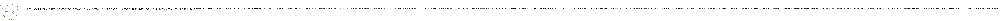

In [53]:
plot_tfidf_matrix(cluster_title,clusters,tfidf_matrix)

Top terms per cluster:
Cluster 0:
 funny
 toxic
 fallen
 comedy
 character
 banning
 loretta
 grandpa
 thing
 would
Cluster 0 titles: CFA_Doc1_DespicableMe3, CFA_Doc4_DespicableMe3, CFA_Doc5_DespicableMe3, CFA_Doc7_DespicableMe3, CFA_Doc8_DespicableMe3, CFA_Doc9_DespicableMe3, CFA_Doc10_DespicableMe3, ACB_Doc1_Grown Ups, ACB_Doc2_Grown Ups, ACB_Doc3_Grown Ups, ACB_Doc4_Grown Ups, ACB_Doc5_Grown Ups, ACB_Doc6_Grown Ups, ACB_Doc7_Grown Ups, ACB_Doc8_Grown Ups, ACB_Doc9_Grown Ups, ACB_Doc10_Grown Ups, VCT_Doc1_DirtyGrandpa, VCT_Doc2_DirtyGrandpa, VCT_Doc3_DirtyGrandpa, VCT_Doc4_DirtyGrandpa, VCT_Doc5_DirtyGrandpa, VCT_Doc6_DirtyGrandpa, VCT_Doc7_DirtyGrandpa, VCT_Doc8_DirtyGrandpa, VCT_Doc9_DirtyGrandpa, VCT_Doc10_DirtyGrandpa, HCC_DocW_LegallyBlonde1, HCC_DocW_LegallyBlonde2, HCC_DocW_LegallyBlonde3, HCC_DocW_LegallyBlonde4, HCC_DocW_LegallyBlonde5, HCC_DocW_LegallyBlonde6, HCC_DocW_LegallyBlonde7, HCC_DocW_LegallyBlonde8, HCC_DocW_LegallyBlonde9, HCC_DocW_LegallyBlonde10, GCS_Doc1_LostC

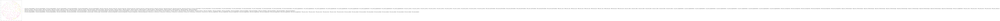

In [54]:
k_means_tfidf(tfidf_matrix,terms,titles,final_processed_text, k=4)
plot_tfidf_matrix(cluster_title,clusters,tfidf_matrix)

In [55]:
cluster_title, clusters, k_means_df = k_means(titles, tfidf_matrix, k =17)
cluster_title

{0: ['YWM_Doc1_Batman',
  'YWM_Doc2_Batman',
  'YWM_Doc3_Batman',
  'YWM_Doc4_Batman',
  'YWM_Doc5_Batman',
  'YWM_Doc6_Batman',
  'YWM_Doc7_Batman',
  'YWM_Doc8_Batman',
  'YWM_Doc9_Batman',
  'YWM_Doc10_Batman'],
 1: ['GCS_Doc1_LostCity',
  'GCS_Doc2_LostCity',
  'GCS_Doc3_LostCity',
  'GCS_Doc4_LostCity',
  'GCS_Doc5_LostCity',
  'GCS_Doc6_LostCity',
  'GCS_Doc7_LostCity',
  'GCS_Doc8_LostCity',
  'GCS_Doc9_LostCity',
  'GCS_Doc10_LostCity'],
 2: ['LLQ_Doc1_AngelHasFallen',
  'LLQ_Doc2_AngelHasFallen',
  'LLQ_Doc3_AngelHasFallen',
  'LLQ_Doc4_AngelHasFallen',
  'LLQ_Doc5_AngelHasFallen',
  'LLQ_Doc6_AngelHasFallen',
  'LLQ_Doc7_AngelHasFallen',
  'LLQ_Doc8_AngelHasFallen',
  'LLQ_Doc9_AngelHasFallen',
  'LLQ_Doc10_AngelHasFallen'],
 3: ['TRH_Doc1_Fresh',
  'TRH_Doc2_Fresh',
  'TRH_Doc3_Fresh',
  'TRH_Doc4_Fresh',
  'TRH_Doc5_Fresh',
  'TRH_Doc6_Fresh',
  'TRH_Doc7_Fresh',
  'TRH_Doc8_Fresh',
  'TRH_Doc9_Fresh',
  'TRH_Doc10_Fresh'],
 4: ['TWH_Doc1_PitchBlack',
  'TWH_Doc2_PitchBlack

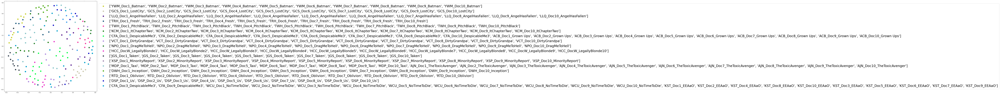

In [56]:
plot_tfidf_matrix(cluster_title,clusters,tfidf_matrix)

Top terms per cluster:
Cluster 0:
 batman
 penguin
 burton
 catwoman
 gotham
 shreck
 return
 keaton
 wayne
 walken
Cluster 0 titles: YWM_Doc1_Batman, YWM_Doc2_Batman, YWM_Doc3_Batman, YWM_Doc4_Batman, YWM_Doc5_Batman, YWM_Doc6_Batman, YWM_Doc7_Batman, YWM_Doc8_Batman, YWM_Doc9_Batman, YWM_Doc10_Batman,Cluster 1:
 loretta
 bullock
 tatum
 sandra
 treasure
 fairfax
 adventure
 stone
 channing
 book
Cluster 1 titles: GCS_Doc1_LostCity, GCS_Doc2_LostCity, GCS_Doc3_LostCity, GCS_Doc4_LostCity, GCS_Doc5_LostCity, GCS_Doc6_LostCity, GCS_Doc7_LostCity, GCS_Doc8_LostCity, GCS_Doc9_LostCity, GCS_Doc10_LostCity,Cluster 2:
 fallen
 banning
 angel
 president
 butler
 trumbull
 london
 service
 gerard
 freeman
Cluster 2 titles: LLQ_Doc1_AngelHasFallen, LLQ_Doc2_AngelHasFallen, LLQ_Doc3_AngelHasFallen, LLQ_Doc4_AngelHasFallen, LLQ_Doc5_AngelHasFallen, LLQ_Doc6_AngelHasFallen, LLQ_Doc7_AngelHasFallen, LLQ_Doc8_AngelHasFallen, LLQ_Doc9_AngelHasFallen, LLQ_Doc10_AngelHasFallen,Cluster 3:
 fresh
 steve


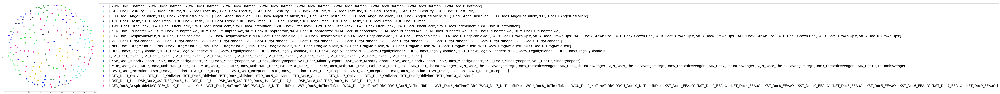

In [57]:
k_means_tfidf(tfidf_matrix,terms,titles,final_processed_text, k=17)
plot_tfidf_matrix(cluster_title,clusters,tfidf_matrix)

In [58]:
cluster_title, clusters, k_means_df = k_means(titles, tfidf_matrix, k =20)
cluster_title

{0: ['TRH_Doc1_Fresh',
  'TRH_Doc2_Fresh',
  'TRH_Doc3_Fresh',
  'TRH_Doc4_Fresh',
  'TRH_Doc5_Fresh',
  'TRH_Doc6_Fresh',
  'TRH_Doc7_Fresh',
  'TRH_Doc8_Fresh',
  'TRH_Doc9_Fresh',
  'TRH_Doc10_Fresh'],
 1: ['JGS_Doc1_Taken',
  'JGS_Doc2_Taken',
  'JGS_Doc3_Taken',
  'JGS_Doc4_Taken',
  'JGS_Doc5_Taken',
  'JGS_Doc6_Taken',
  'JGS_Doc7_Taken',
  'JGS_Doc8_Taken',
  'JGS_Doc9_Taken',
  'JGS_Doc10_Taken'],
 2: ['GCS_Doc1_LostCity',
  'GCS_Doc2_LostCity',
  'GCS_Doc3_LostCity',
  'GCS_Doc4_LostCity',
  'GCS_Doc5_LostCity',
  'GCS_Doc6_LostCity',
  'GCS_Doc7_LostCity',
  'GCS_Doc8_LostCity',
  'GCS_Doc9_LostCity',
  'GCS_Doc10_LostCity'],
 3: ['YWM_Doc1_Batman',
  'YWM_Doc2_Batman',
  'YWM_Doc3_Batman',
  'YWM_Doc4_Batman',
  'YWM_Doc5_Batman',
  'YWM_Doc6_Batman',
  'YWM_Doc7_Batman',
  'YWM_Doc8_Batman',
  'YWM_Doc9_Batman',
  'YWM_Doc10_Batman'],
 4: ['DWH_Doc1_Inception',
  'DWH_Doc2_Inception',
  'DWH_Doc3_Inception',
  'DWH_Doc4_Inception',
  'DWH_Doc5_Inception',
  'DWH_Doc6_Incep

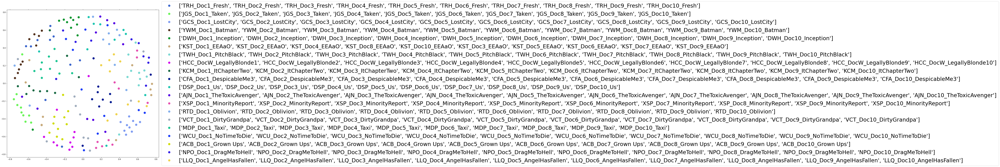

In [59]:
plot_tfidf_matrix(cluster_title,clusters,tfidf_matrix)

Top terms per cluster:
Cluster 0:
 fresh
 steve
 dating
 edgarjones
 woman
 mollie
 steves
 cave
 horror
 daisy
Cluster 0 titles: TRH_Doc1_Fresh, TRH_Doc2_Fresh, TRH_Doc3_Fresh, TRH_Doc4_Fresh, TRH_Doc5_Fresh, TRH_Doc6_Fresh, TRH_Doc7_Fresh, TRH_Doc8_Fresh, TRH_Doc9_Fresh, TRH_Doc10_Fresh,Cluster 1:
 bryan
 neeson
 taken
 paris
 daughter
 mill
 besson
 action
 janssen
 albanian
Cluster 1 titles: JGS_Doc1_Taken, JGS_Doc2_Taken, JGS_Doc3_Taken, JGS_Doc4_Taken, JGS_Doc5_Taken, JGS_Doc6_Taken, JGS_Doc7_Taken, JGS_Doc8_Taken, JGS_Doc9_Taken, JGS_Doc10_Taken,Cluster 2:
 loretta
 bullock
 tatum
 sandra
 treasure
 fairfax
 adventure
 stone
 channing
 book
Cluster 2 titles: GCS_Doc1_LostCity, GCS_Doc2_LostCity, GCS_Doc3_LostCity, GCS_Doc4_LostCity, GCS_Doc5_LostCity, GCS_Doc6_LostCity, GCS_Doc7_LostCity, GCS_Doc8_LostCity, GCS_Doc9_LostCity, GCS_Doc10_LostCity,Cluster 3:
 batman
 penguin
 burton
 catwoman
 gotham
 shreck
 return
 keaton
 wayne
 walken
Cluster 3 titles: YWM_Doc1_Batman, YWM_Doc2

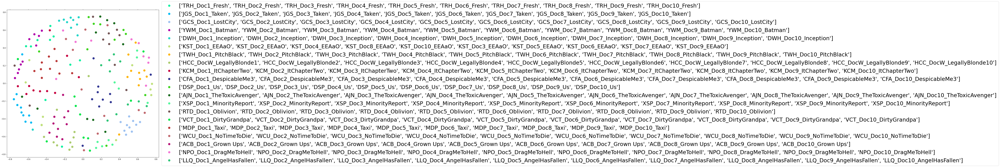

In [60]:
k_means_tfidf(tfidf_matrix,terms,titles,final_processed_text, k=20)
plot_tfidf_matrix(cluster_title,clusters,tfidf_matrix)

In [61]:
def doc2vec_with_titles(corpus, processed_text, titles, vector_size = 300):
    #function to created doc2vec matrix
    documents = [TaggedDocument(doc, [i]) for i, doc in enumerate(corpus)]

    model = Doc2Vec(documents, vector_size=300, window=3, min_count=2, workers=4)

    doc2vec_df=pd.DataFrame()
    for i in range(0,len(processed_text)):
        vector=pd.DataFrame(model.infer_vector(processed_text[i])).transpose()
        doc2vec_df=pd.concat([doc2vec_df,vector], axis=0)

    doc2vec_df=doc2vec_df.reset_index()

    doc_titles={'title': titles}
    t=pd.DataFrame(doc_titles)

    doc2vec_df=pd.concat([doc2vec_df,t], axis=1)

    doc2vec_df=doc2vec_df.drop('index', axis=1)
    return doc2vec_df

def k_means_doc2vec(doc2vec_df, final_processed_text,titles, k = 5):
    
    #this is a funciton to create the k_means outputs using the doc2vec matrics.  Required inputs
    #include the doc2vec matrix, and desired number of clusters.
    doc2vec_k_means=doc2vec_df.drop('title', axis=1)

    km = KMeans(n_clusters=k, random_state =89)
    km.fit(doc2vec_k_means)

    clusters_d2v = km.labels_.tolist()

    Dictionary={'Doc Name':titles, 'Cluster':clusters_d2v,  'Text': final_processed_text}
    frame=pd.DataFrame(Dictionary, columns=['Cluster', 'Doc Name','Text'])

    #dictionary to store clusters and respective titles
    cluster_title={}

    #note doc2vec clusters will not have individual words due to the vector representation
    #is based on the entire document not indvidual words. As a result, there won't be individual
    #word outputs from each cluster.   
    for i in range(k):
        print("Cluster %d:" % i)
        temp=frame[frame['Cluster']==i]
        temp_title_list=[]
        for title in temp['Doc Name']:
            print(' %s ' % title, end='\n')
            temp_title_list.append(title)
        cluster_title[i]=temp_title_list



In [62]:
doc2vec_model = doc2vec_with_titles(final_processed_text, processed_text,titles)
doc2vec_model.index = titles
# k_means_doc2vec(doc2vec_model, final_processed_text,titles, k =10)

In [63]:
#print(doc2vec_model)

In [64]:
k_list = [2,3, 4, 5, 7, 9 ,11, 13, 15, 17, 19, 20, 21]
# #silhoutte score list
sil_scores = []

doc2vec_k_means=doc2vec_model.drop('title', axis=1)

for k in k_list:
    km = KMeans(n_clusters=k, random_state =89)
    km.fit(doc2vec_k_means)
    labels = km.labels_.tolist()
    score = silhouette_score(doc2vec_k_means, labels)
    sil_scores.append(score)
    k_scores.append(score)
    print(f'k={k}, Silhouette Score: %.3f' % score)  

k=2, Silhouette Score: 0.005
k=3, Silhouette Score: 0.004
k=4, Silhouette Score: 0.002
k=5, Silhouette Score: 0.002
k=7, Silhouette Score: 0.000
k=9, Silhouette Score: -0.001
k=11, Silhouette Score: -0.002
k=13, Silhouette Score: -0.003
k=15, Silhouette Score: -0.003
k=17, Silhouette Score: -0.005
k=19, Silhouette Score: -0.004
k=20, Silhouette Score: -0.003
k=21, Silhouette Score: -0.003


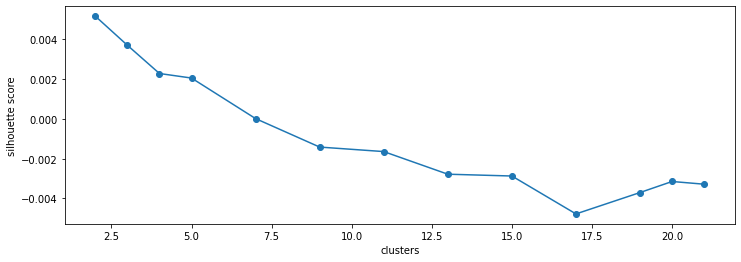

In [65]:
plt.figure(figsize=(12, 4))
plt.scatter(k_list, sil_scores)
plt.plot(k_list, sil_scores)
plt.xlabel("clusters")
plt.ylabel("silhouette score")
plt.show()

In [66]:
k_means_doc2vec(doc2vec_model, final_processed_text,titles, k =2)

Cluster 0:
 CFA_Doc1_DespicableMe3 
 CFA_Doc2_DespicableMe3 
 CFA_Doc3_DespicableMe3 
 CFA_Doc6_DespicableMe3 
 CFA_Doc7_DespicableMe3 
 CFA_Doc8_DespicableMe3 
 ACB_Doc1_Grown Ups 
 ACB_Doc2_Grown Ups 
 ACB_Doc3_Grown Ups 
 ACB_Doc5_Grown Ups 
 ACB_Doc7_Grown Ups 
 ACB_Doc10_Grown Ups 
 VCT_Doc5_DirtyGrandpa 
 VCT_Doc8_DirtyGrandpa 
 VCT_Doc9_DirtyGrandpa 
 VCT_Doc10_DirtyGrandpa 
 HCC_DocW_LegallyBlonde3 
 HCC_DocW_LegallyBlonde5 
 HCC_DocW_LegallyBlonde8 
 HCC_DocW_LegallyBlonde9 
 GCS_Doc1_LostCity 
 GCS_Doc2_LostCity 
 GCS_Doc4_LostCity 
 GCS_Doc5_LostCity 
 GCS_Doc7_LostCity 
 GCS_Doc9_LostCity 
 WCU_Doc1_NoTimeToDie 
 WCU_Doc4_NoTimeToDie 
 WCU_Doc5_NoTimeToDie 
 WCU_Doc7_NoTimeToDie 
 WCU_Doc8_NoTimeToDie 
 WCU_Doc9_NoTimeToDie 
 WCU_Doc10_NoTimeToDie 
 MDP_Doc2_Taxi 
 MDP_Doc3_Taxi 
 MDP_Doc4_Taxi 
 MDP_Doc5_Taxi 
 MDP_Doc7_Taxi 
 MDP_Doc9_Taxi 
 JGS_Doc2_Taken 
 JGS_Doc6_Taken 
 JGS_Doc7_Taken 
 JGS_Doc10_Taken 
 DWH_Doc1_Inception 
 DWH_Doc2_Inception 
 DWH_Doc3_Inception 
 

In [67]:
k_means_doc2vec(doc2vec_model, final_processed_text,titles, k =4)

Cluster 0:
 CFA_Doc3_DespicableMe3 
 CFA_Doc4_DespicableMe3 
 CFA_Doc7_DespicableMe3 
 ACB_Doc1_Grown Ups 
 ACB_Doc2_Grown Ups 
 VCT_Doc1_DirtyGrandpa 
 VCT_Doc4_DirtyGrandpa 
 VCT_Doc5_DirtyGrandpa 
 VCT_Doc10_DirtyGrandpa 
 HCC_DocW_LegallyBlonde5 
 HCC_DocW_LegallyBlonde6 
 HCC_DocW_LegallyBlonde10 
 GCS_Doc2_LostCity 
 GCS_Doc6_LostCity 
 WCU_Doc5_NoTimeToDie 
 WCU_Doc8_NoTimeToDie 
 MDP_Doc4_Taxi 
 MDP_Doc9_Taxi 
 JGS_Doc2_Taken 
 JGS_Doc9_Taken 
 DWH_Doc1_Inception 
 DWH_Doc3_Inception 
 LLQ_Doc2_AngelHasFallen 
 KCM_Doc1_ItChapterTwo 
 KCM_Doc2_ItChapterTwo 
 KCM_Doc7_ItChapterTwo 
 KCM_Doc9_ItChapterTwo 
 AJN_Doc5_TheToxicAvenger 
 AJN_Doc8_TheToxicAvenger 
 DSP_Doc1_Us 
 DSP_Doc3_Us 
 DSP_Doc5_Us 
 NPO_Doc2_DragMeToHell 
 NPO_Doc3_DragMeToHell 
 TRH_Doc1_Fresh 
 TRH_Doc3_Fresh 
 TRH_Doc4_Fresh 
 TRH_Doc9_Fresh 
 KST_Doc7_EEAaO 
 XSP_Doc2_MinorityReport 
 XSP_Doc8_MinorityReport 
 RTD_Doc3_Oblivion 
 YWM_Doc3_Batman 
 YWM_Doc5_Batman 
 YWM_Doc8_Batman 
 YWM_Doc9_Batman 
 TWH_Do

In [68]:
k_means_doc2vec(doc2vec_model, final_processed_text,titles, k =13)

Cluster 0:
 ACB_Doc2_Grown Ups 
 ACB_Doc7_Grown Ups 
 VCT_Doc8_DirtyGrandpa 
 GCS_Doc4_LostCity 
 GCS_Doc6_LostCity 
 KCM_Doc3_ItChapterTwo 
 KCM_Doc8_ItChapterTwo 
 AJN_Doc2_TheToxicAvenger 
 DSP_Doc6_Us 
 KST_Doc7_EEAaO 
 XSP_Doc2_MinorityReport 
 TWH_Doc6_PitchBlack 
Cluster 1:
 VCT_Doc9_DirtyGrandpa 
 HCC_DocW_LegallyBlonde3 
 HCC_DocW_LegallyBlonde6 
 HCC_DocW_LegallyBlonde10 
 WCU_Doc7_NoTimeToDie 
 JGS_Doc7_Taken 
 AJN_Doc1_TheToxicAvenger 
 AJN_Doc4_TheToxicAvenger 
 DSP_Doc3_Us 
 KST_Doc4_EEAaO 
 XSP_Doc3_MinorityReport 
 XSP_Doc9_MinorityReport 
 TWH_Doc4_PitchBlack 
Cluster 2:
 CFA_Doc5_DespicableMe3 
 CFA_Doc9_DespicableMe3 
 ACB_Doc5_Grown Ups 
 HCC_DocW_LegallyBlonde2 
 HCC_DocW_LegallyBlonde4 
 MDP_Doc4_Taxi 
 JGS_Doc2_Taken 
 JGS_Doc5_Taken 
 LLQ_Doc4_AngelHasFallen 
 TRH_Doc4_Fresh 
 KST_Doc6_EEAaO 
 RTD_Doc1_Oblivion 
 RTD_Doc7_Oblivion 
 YWM_Doc6_Batman 
 YWM_Doc10_Batman 
 TWH_Doc3_PitchBlack 
 TWH_Doc5_PitchBlack 
Cluster 3:
 CFA_Doc10_DespicableMe3 
 DSP_Doc8_Us 


In [69]:
k_means_doc2vec(doc2vec_model, final_processed_text,titles, k =15)

Cluster 0:
 HCC_DocW_LegallyBlonde1 
 WCU_Doc3_NoTimeToDie 
 MDP_Doc4_Taxi 
 KCM_Doc1_ItChapterTwo 
 KCM_Doc10_ItChapterTwo 
 DSP_Doc1_Us 
 DSP_Doc8_Us 
 TWH_Doc6_PitchBlack 
Cluster 1:
 ACB_Doc7_Grown Ups 
 VCT_Doc8_DirtyGrandpa 
 HCC_DocW_LegallyBlonde5 
 HCC_DocW_LegallyBlonde7 
 HCC_DocW_LegallyBlonde8 
 GCS_Doc4_LostCity 
 GCS_Doc5_LostCity 
 JGS_Doc3_Taken 
 LLQ_Doc1_AngelHasFallen 
 KCM_Doc3_ItChapterTwo 
 KCM_Doc4_ItChapterTwo 
 KCM_Doc9_ItChapterTwo 
 AJN_Doc2_TheToxicAvenger 
 XSP_Doc6_MinorityReport 
 RTD_Doc8_Oblivion 
 YWM_Doc3_Batman 
 YWM_Doc5_Batman 
 TWH_Doc3_PitchBlack 
 TWH_Doc10_PitchBlack 
Cluster 2:
 ACB_Doc3_Grown Ups 
 VCT_Doc3_DirtyGrandpa 
 HCC_DocW_LegallyBlonde9 
 GCS_Doc3_LostCity 
 WCU_Doc8_NoTimeToDie 
 JGS_Doc9_Taken 
 AJN_Doc8_TheToxicAvenger 
 DSP_Doc6_Us 
 KST_Doc9_EEAaO 
 XSP_Doc10_MinorityReport 
 YWM_Doc7_Batman 
Cluster 3:
 CFA_Doc2_DespicableMe3 
 VCT_Doc6_DirtyGrandpa 
 VCT_Doc9_DirtyGrandpa 
 VCT_Doc10_DirtyGrandpa 
 HCC_DocW_LegallyBlonde3 
 H

In [70]:
k_means_doc2vec(doc2vec_model, final_processed_text,titles, k =20)

Cluster 0:
 HCC_DocW_LegallyBlonde10 
 WCU_Doc7_NoTimeToDie 
 MDP_Doc7_Taxi 
 JGS_Doc6_Taken 
 AJN_Doc4_TheToxicAvenger 
 TRH_Doc8_Fresh 
 TWH_Doc1_PitchBlack 
 TWH_Doc2_PitchBlack 
 TWH_Doc7_PitchBlack 
Cluster 1:
 CFA_Doc6_DespicableMe3 
 HCC_DocW_LegallyBlonde8 
 GCS_Doc5_LostCity 
 MDP_Doc2_Taxi 
 MDP_Doc9_Taxi 
 TRH_Doc10_Fresh 
 RTD_Doc1_Oblivion 
Cluster 2:
 JGS_Doc8_Taken 
 DWH_Doc3_Inception 
 LLQ_Doc6_AngelHasFallen 
 KCM_Doc6_ItChapterTwo 
 DSP_Doc1_Us 
 DSP_Doc10_Us 
 TRH_Doc3_Fresh 
 KST_Doc2_EEAaO 
 KST_Doc9_EEAaO 
 TWH_Doc10_PitchBlack 
Cluster 3:
 ACB_Doc9_Grown Ups 
 DWH_Doc2_Inception 
 AJN_Doc2_TheToxicAvenger 
 TRH_Doc2_Fresh 
 XSP_Doc5_MinorityReport 
 RTD_Doc9_Oblivion 
 YWM_Doc1_Batman 
 TWH_Doc3_PitchBlack 
Cluster 4:
 VCT_Doc5_DirtyGrandpa 
 HCC_DocW_LegallyBlonde7 
 MDP_Doc8_Taxi 
 LLQ_Doc8_AngelHasFallen 
 AJN_Doc3_TheToxicAvenger 
 AJN_Doc6_TheToxicAvenger 
 AJN_Doc10_TheToxicAvenger 
 NPO_Doc1_DragMeToHell 
 NPO_Doc6_DragMeToHell 
 TRH_Doc6_Fresh 
 XSP_Doc1

## Doc2vec second experiment

In [71]:
def doc2vec1_with_titles(corpus, processed_text, titles, vector_size = 600):
    #function to created doc2vec matrix
    documents = [TaggedDocument(doc, [i]) for i, doc in enumerate(corpus)]

    model = Doc2Vec(documents, vector_size=600, window=3, min_count=2, workers=4)

    doc2vec1_df=pd.DataFrame()
    for i in range(0,len(processed_text)):
        vector=pd.DataFrame(model.infer_vector(processed_text[i])).transpose()
        doc2vec1_df=pd.concat([doc2vec1_df,vector], axis=0)

    doc2vec1_df=doc2vec1_df.reset_index()

    doc_titles={'title': titles}
    t=pd.DataFrame(doc_titles)

    doc2vec1_df=pd.concat([doc2vec1_df,t], axis=1)

    doc2vec1_df=doc2vec1_df.drop('index', axis=1)
    return doc2vec1_df

def k_means_doc2vec1(doc2vec1_df, final_processed_text,titles, k = 5):
    
    #this is a funciton to create the k_means outputs using the doc2vec matrics.  Required inputs
    #include the doc2vec matrix, and desired number of clusters.
    doc2vec1_k_means=doc2vec1_df.drop('title', axis=1)

    km = KMeans(n_clusters=k, random_state =89)
    km.fit(doc2vec1_k_means)

    clusters_d2v = km.labels_.tolist()

    Dictionary={'Doc Name':titles, 'Cluster':clusters_d2v,  'Text': final_processed_text}
    frame=pd.DataFrame(Dictionary, columns=['Cluster', 'Doc Name','Text'])

    #dictionary to store clusters and respective titles
    cluster_title={}

    #note doc2vec clusters will not have individual words due to the vector representation
    #is based on the entire document not indvidual words. As a result, there won't be individual
    #word outputs from each cluster.   
    for i in range(k):
        print("Cluster %d:" % i)
        temp=frame[frame['Cluster']==i]
        temp_title_list=[]
        for title in temp['Doc Name']:
            print(' %s ' % title, end='\n')
            temp_title_list.append(title)
        cluster_title[i]=temp_title_list



In [72]:
doc2vec1_model = doc2vec1_with_titles(final_processed_text, processed_text,titles)
doc2vec1_model.index = titles
# k_means_doc2vec1(doc2vec1_model, final_processed_text,titles, k =10)

In [73]:
k_list = [2, 3, 4, 5, 7, 9 ,11, 13, 15, 17, 19, 20, 21]
# #silhoutte score list
sil_scores = []

doc2vec1_k_means=doc2vec1_model.drop('title', axis=1)

for k in k_list:
    km = KMeans(n_clusters=k, random_state =89)
    km.fit(doc2vec1_k_means)
    labels = km.labels_.tolist()
    score = silhouette_score(doc2vec1_k_means, labels)
    sil_scores.append(score)
    k_scores.append(score)
    print(f'k={k}, Silhouette Score: %.3f' % score)

k=2, Silhouette Score: 0.003
k=3, Silhouette Score: 0.001
k=4, Silhouette Score: 0.001
k=5, Silhouette Score: 0.000
k=7, Silhouette Score: -0.003
k=9, Silhouette Score: -0.002
k=11, Silhouette Score: -0.002
k=13, Silhouette Score: -0.005
k=15, Silhouette Score: -0.004
k=17, Silhouette Score: -0.006
k=19, Silhouette Score: -0.002
k=20, Silhouette Score: -0.004
k=21, Silhouette Score: -0.004


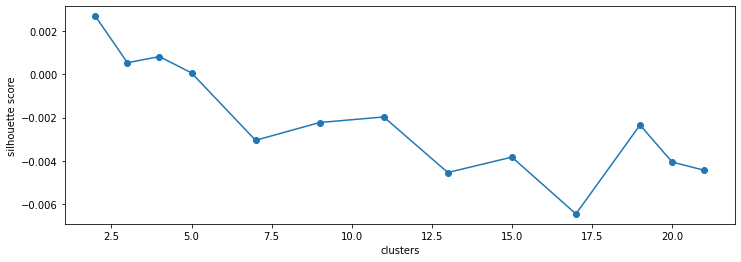

In [74]:
plt.figure(figsize=(12, 4))
plt.scatter(k_list, sil_scores)
plt.plot(k_list, sil_scores)
plt.xlabel("clusters")
plt.ylabel("silhouette score")
plt.show()

In [75]:
k_means_doc2vec1(doc2vec1_model, final_processed_text,titles, k =2)

Cluster 0:
 CFA_Doc10_DespicableMe3 
 ACB_Doc1_Grown Ups 
 ACB_Doc2_Grown Ups 
 ACB_Doc3_Grown Ups 
 ACB_Doc6_Grown Ups 
 VCT_Doc4_DirtyGrandpa 
 VCT_Doc5_DirtyGrandpa 
 VCT_Doc6_DirtyGrandpa 
 VCT_Doc8_DirtyGrandpa 
 VCT_Doc9_DirtyGrandpa 
 HCC_DocW_LegallyBlonde1 
 HCC_DocW_LegallyBlonde3 
 HCC_DocW_LegallyBlonde4 
 HCC_DocW_LegallyBlonde5 
 HCC_DocW_LegallyBlonde7 
 HCC_DocW_LegallyBlonde9 
 HCC_DocW_LegallyBlonde10 
 GCS_Doc5_LostCity 
 GCS_Doc9_LostCity 
 WCU_Doc6_NoTimeToDie 
 WCU_Doc10_NoTimeToDie 
 MDP_Doc3_Taxi 
 MDP_Doc4_Taxi 
 MDP_Doc5_Taxi 
 MDP_Doc7_Taxi 
 MDP_Doc9_Taxi 
 JGS_Doc2_Taken 
 JGS_Doc4_Taken 
 JGS_Doc6_Taken 
 JGS_Doc7_Taken 
 JGS_Doc10_Taken 
 DWH_Doc1_Inception 
 DWH_Doc3_Inception 
 DWH_Doc4_Inception 
 DWH_Doc6_Inception 
 DWH_Doc9_Inception 
 LLQ_Doc1_AngelHasFallen 
 LLQ_Doc3_AngelHasFallen 
 LLQ_Doc4_AngelHasFallen 
 LLQ_Doc7_AngelHasFallen 
 LLQ_Doc8_AngelHasFallen 
 LLQ_Doc9_AngelHasFallen 
 KCM_Doc1_ItChapterTwo 
 KCM_Doc3_ItChapterTwo 
 KCM_Doc9_ItCh

In [76]:
k_means_doc2vec1(doc2vec1_model, final_processed_text,titles, k =4)

Cluster 0:
 CFA_Doc1_DespicableMe3 
 CFA_Doc2_DespicableMe3 
 CFA_Doc4_DespicableMe3 
 CFA_Doc5_DespicableMe3 
 ACB_Doc1_Grown Ups 
 ACB_Doc9_Grown Ups 
 VCT_Doc5_DirtyGrandpa 
 VCT_Doc10_DirtyGrandpa 
 HCC_DocW_LegallyBlonde1 
 HCC_DocW_LegallyBlonde7 
 HCC_DocW_LegallyBlonde10 
 GCS_Doc1_LostCity 
 WCU_Doc1_NoTimeToDie 
 WCU_Doc6_NoTimeToDie 
 MDP_Doc2_Taxi 
 MDP_Doc4_Taxi 
 MDP_Doc9_Taxi 
 MDP_Doc10_Taxi 
 JGS_Doc4_Taken 
 JGS_Doc6_Taken 
 DWH_Doc2_Inception 
 DWH_Doc3_Inception 
 DWH_Doc9_Inception 
 LLQ_Doc6_AngelHasFallen 
 KCM_Doc1_ItChapterTwo 
 KCM_Doc2_ItChapterTwo 
 KCM_Doc7_ItChapterTwo 
 KCM_Doc9_ItChapterTwo 
 KCM_Doc10_ItChapterTwo 
 AJN_Doc2_TheToxicAvenger 
 AJN_Doc6_TheToxicAvenger 
 AJN_Doc8_TheToxicAvenger 
 AJN_Doc10_TheToxicAvenger 
 DSP_Doc1_Us 
 DSP_Doc7_Us 
 DSP_Doc9_Us 
 TRH_Doc5_Fresh 
 TRH_Doc6_Fresh 
 TRH_Doc7_Fresh 
 TRH_Doc10_Fresh 
 KST_Doc4_EEAaO 
 KST_Doc8_EEAaO 
 KST_Doc5_EEAaO 
 KST_Doc6_EEAaO 
 KST_Doc7_EEAaO 
 KST_Doc9_EEAaO 
 XSP_Doc8_MinorityRepo

In [77]:
k_means_doc2vec1(doc2vec1_model, final_processed_text,titles, k =13)

Cluster 0:
 KCM_Doc2_ItChapterTwo 
 KST_Doc7_EEAaO 
Cluster 1:
 ACB_Doc2_Grown Ups 
 ACB_Doc7_Grown Ups 
 VCT_Doc1_DirtyGrandpa 
 GCS_Doc5_LostCity 
 DWH_Doc5_Inception 
 LLQ_Doc7_AngelHasFallen 
 KCM_Doc3_ItChapterTwo 
 AJN_Doc8_TheToxicAvenger 
 DSP_Doc1_Us 
 DSP_Doc3_Us 
 NPO_Doc10_DragMeToHell 
 KST_Doc9_EEAaO 
 RTD_Doc6_Oblivion 
Cluster 2:
 ACB_Doc5_Grown Ups 
 VCT_Doc6_DirtyGrandpa 
 VCT_Doc10_DirtyGrandpa 
 HCC_DocW_LegallyBlonde1 
 HCC_DocW_LegallyBlonde5 
 HCC_DocW_LegallyBlonde10 
 WCU_Doc8_NoTimeToDie 
 MDP_Doc8_Taxi 
 MDP_Doc9_Taxi 
 MDP_Doc10_Taxi 
 JGS_Doc1_Taken 
 JGS_Doc3_Taken 
 JGS_Doc5_Taken 
 DWH_Doc6_Inception 
 DWH_Doc9_Inception 
 DWH_Doc10_Inception 
 KCM_Doc7_ItChapterTwo 
 KCM_Doc10_ItChapterTwo 
 NPO_Doc1_DragMeToHell 
 TRH_Doc4_Fresh 
 TRH_Doc7_Fresh 
 TRH_Doc9_Fresh 
 KST_Doc4_EEAaO 
 KST_Doc8_EEAaO 
 XSP_Doc1_MinorityReport 
 XSP_Doc7_MinorityReport 
 RTD_Doc3_Oblivion 
 RTD_Doc4_Oblivion 
 RTD_Doc5_Oblivion 
 RTD_Doc9_Oblivion 
 YWM_Doc3_Batman 
 YWM_Doc

In [78]:
k_means_doc2vec1(doc2vec1_model, final_processed_text,titles, k =15)

Cluster 0:
 HCC_DocW_LegallyBlonde4 
 JGS_Doc2_Taken 
 DWH_Doc8_Inception 
 KCM_Doc8_ItChapterTwo 
 AJN_Doc10_TheToxicAvenger 
 NPO_Doc3_DragMeToHell 
 NPO_Doc5_DragMeToHell 
 XSP_Doc1_MinorityReport 
 XSP_Doc6_MinorityReport 
 TWH_Doc3_PitchBlack 
 TWH_Doc9_PitchBlack 
Cluster 1:
 CFA_Doc9_DespicableMe3 
 ACB_Doc5_Grown Ups 
 HCC_DocW_LegallyBlonde9 
 HCC_DocW_LegallyBlonde10 
 MDP_Doc4_Taxi 
 LLQ_Doc4_AngelHasFallen 
 DSP_Doc7_Us 
 TRH_Doc5_Fresh 
 XSP_Doc8_MinorityReport 
 RTD_Doc9_Oblivion 
Cluster 2:
 CFA_Doc7_DespicableMe3 
 GCS_Doc7_LostCity 
 GCS_Doc9_LostCity 
 GCS_Doc10_LostCity 
 WCU_Doc5_NoTimeToDie 
 WCU_Doc10_NoTimeToDie 
 MDP_Doc7_Taxi 
 JGS_Doc9_Taken 
 TRH_Doc4_Fresh 
 XSP_Doc2_MinorityReport 
Cluster 3:
 CFA_Doc2_DespicableMe3 
 HCC_DocW_LegallyBlonde3 
 GCS_Doc1_LostCity 
 GCS_Doc5_LostCity 
 WCU_Doc1_NoTimeToDie 
 WCU_Doc2_NoTimeToDie 
 WCU_Doc3_NoTimeToDie 
 WCU_Doc4_NoTimeToDie 
 WCU_Doc8_NoTimeToDie 
 JGS_Doc7_Taken 
 DWH_Doc2_Inception 
 LLQ_Doc3_AngelHasFallen 

In [79]:
k_means_doc2vec1(doc2vec1_model, final_processed_text,titles, k =20)

Cluster 0:
 VCT_Doc5_DirtyGrandpa 
 VCT_Doc9_DirtyGrandpa 
 HCC_DocW_LegallyBlonde8 
 KCM_Doc9_ItChapterTwo 
 AJN_Doc1_TheToxicAvenger 
 AJN_Doc9_TheToxicAvenger 
 XSP_Doc8_MinorityReport 
 YWM_Doc9_Batman 
 TWH_Doc4_PitchBlack 
Cluster 1:
 ACB_Doc1_Grown Ups 
 GCS_Doc2_LostCity 
 DWH_Doc3_Inception 
 KCM_Doc6_ItChapterTwo 
 DSP_Doc4_Us 
 TRH_Doc4_Fresh 
 TRH_Doc9_Fresh 
 RTD_Doc8_Oblivion 
Cluster 2:
 VCT_Doc2_DirtyGrandpa 
 GCS_Doc3_LostCity 
 WCU_Doc3_NoTimeToDie 
 WCU_Doc5_NoTimeToDie 
 JGS_Doc4_Taken 
 JGS_Doc6_Taken 
 DWH_Doc6_Inception 
 KCM_Doc8_ItChapterTwo 
 AJN_Doc10_TheToxicAvenger 
 DSP_Doc9_Us 
 TWH_Doc10_PitchBlack 
Cluster 3:
 CFA_Doc3_DespicableMe3 
 ACB_Doc8_Grown Ups 
 WCU_Doc6_NoTimeToDie 
 MDP_Doc6_Taxi 
 LLQ_Doc6_AngelHasFallen 
 NPO_Doc1_DragMeToHell 
 RTD_Doc1_Oblivion 
 RTD_Doc2_Oblivion 
 YWM_Doc5_Batman 
Cluster 4:
 CFA_Doc1_DespicableMe3 
 CFA_Doc4_DespicableMe3 
 HCC_DocW_LegallyBlonde6 
 GCS_Doc10_LostCity 
 MDP_Doc9_Taxi 
 KCM_Doc1_ItChapterTwo 
 KCM_Doc7

### Supervised Models

In [80]:
def classifiers(x, y, model_type, cv = 3):
    
    #this function is to fit 3 different model scenarios.  Support vector machines, logistic regressions, naive bayes.
    #svm = Support vector machin
    #logistic = Logistic regression
    #naive_bayes = Naive Bayes Multinomial
    
    #can define cv value for cross validation.
    
    #function returns the train test split scores of each model.
    
    if model_type == 'svm':
        print("svm")
        model = SVC()

    elif model_type == 'logistic':
        print("logistic")
        model = LogisticRegression()

    elif model_type == 'naive_bayes':
        print("naive_bayes")
        model = MultinomialNB()
    
    elif model_type == 'randomforest':
        print("randomforest")
        model = RandomForestClassifier()

    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=42)
    model.fit(X_train, y_train)
    
    predictions = model.predict(X_test)
    accy = accuracy_score(y_test, predictions)
    conf_mat = confusion_matrix(y_test, predictions)
    conf_matrix = sns.heatmap(conf_mat, square=True, annot=True, cmap='Blues', fmt='d', cbar=False)
    f1 = f1_score(y_test, predictions)
    return print(f"Accuracy = {accy}"), print(f"F1 Score = {f1}"), conf_matrix 


## Generate Labels for Supervised Learning Models

In [81]:
labels = data['Review Type (pos or neg)'].apply(lambda x: 0 if x.lower().split(' ')[0] == 'negative' else 1)
print(labels)

0      1
1      1
2      1
3      1
4      1
      ..
195    0
196    0
197    0
198    0
199    0
Name: Review Type (pos or neg), Length: 200, dtype: int64


## Classification based on TF_IDF

## Suppot Vector Machine

Support vector machines (SVMs):
https://scikit-learn.org/stable/modules/svm.html

Set of supervised learning methods used for classification, regression and outliers detection

svm
Accuracy = 0.3939393939393939
F1 Score = 0.5555555555555556


(None, None, <matplotlib.axes._subplots.AxesSubplot at 0x7fe29c77cd60>)

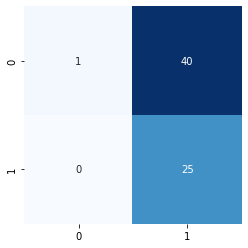

In [82]:
classifiers(tfidf_matrix, labels, 'svm')

### Logistic Regression Model

sklearn.linear_model.LogisticRegression:
https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html

Logistic Regression Default Parameters:
class sklearn.linear_model.LogisticRegression(penalty='l2', *, dual=False, tol=0.0001, C=1.0, fit_intercept=True, intercept_scaling=1, class_weight=None, random_state=None, solver='lbfgs', max_iter=100, multi_class='auto', verbose=0, warm_start=False, n_jobs=None, l1_ratio=None)

logistic
Accuracy = 0.3484848484848485
F1 Score = 0.49411764705882355


(None, None, <matplotlib.axes._subplots.AxesSubplot at 0x7fe29b5f4400>)

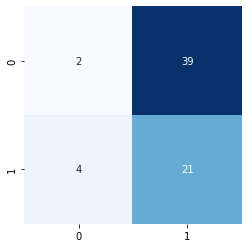

In [83]:
classifiers(tfidf_matrix, labels, 'logistic')

### Naive Bayes

Naive Bayes:
https://scikit-learn.org/stable/modules/naive_bayes.html

Naive Bayes methods are a set of supervised learning algorithms based on applying Bayes’ theorem with the “naive” assumption of conditional independence between every pair of features given the value of the class variable.

naive_bayes
Accuracy = 0.3484848484848485
F1 Score = 0.49411764705882355


(None, None, <matplotlib.axes._subplots.AxesSubplot at 0x7fe29d25d5b0>)

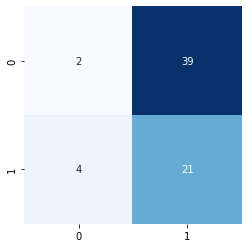

In [84]:
classifiers(tfidf_matrix, labels, 'naive_bayes')

### Random Forest

sklearn.ensemble.RandomForestClassifier:
https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html

RandomForest Classifier Default Parameters:
class sklearn.ensemble.RandomForestClassifier(n_estimators=100, *, criterion='gini', max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features='auto', max_leaf_nodes=None, min_impurity_decrease=0.0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, class_weight=None, ccp_alpha=0.0, max_samples=None)

randomforest
Accuracy = 0.3939393939393939
F1 Score = 0.5454545454545454


(None, None, <matplotlib.axes._subplots.AxesSubplot at 0x7fe29d5a0ee0>)

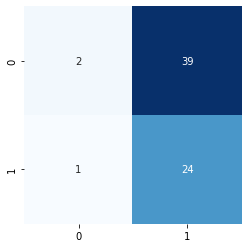

In [85]:
classifiers(tfidf_matrix, labels, 'randomforest')

### Classification based on doc2vec 300

In [86]:
documents = [TaggedDocument(doc, [i]) for i, doc in enumerate(final_processed_text)]
model = Doc2Vec(documents, vectore_size = 300, window =2, min_count=1, workers=4)

In [87]:
doc2vec_df=pd.DataFrame()
for i in range(0,len(processed_text)):
    vector=pd.DataFrame(model.infer_vector(processed_text[i])).transpose()
    doc2vec_df=pd.concat([doc2vec_df,vector], axis=0)

doc2vec_df=doc2vec_df.reset_index()

doc_titles={'title': titles}
t=pd.DataFrame(doc_titles)

doc2vec_df=pd.concat([doc2vec_df,t], axis=1)

doc2vec_df=doc2vec_df.drop('index', axis=1)


In [88]:
doc2vec_data=doc2vec_df.drop('title', axis =1)
X_train_doc, X_test_doc, y_train_doc, y_test_doc = train_test_split(doc2vec_data, labels, test_size=0.33, random_state=42)

In [89]:
labels = data['Review Type (pos or neg)'].apply(lambda x: 0 if x.lower().split(' ')[0] == 'negative' else 1)
print(labels)

0      1
1      1
2      1
3      1
4      1
      ..
195    0
196    0
197    0
198    0
199    0
Name: Review Type (pos or neg), Length: 200, dtype: int64


svm
Accuracy = 0.36363636363636365
F1 Score = 0.4615384615384615


(None, None, <matplotlib.axes._subplots.AxesSubplot at 0x7fe29c77c280>)

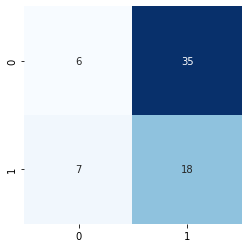

In [90]:
classifiers(doc2vec_data, labels, 'svm')

logistic
Accuracy = 0.3787878787878788
F1 Score = 0.5494505494505494


(None, None, <matplotlib.axes._subplots.AxesSubplot at 0x7fe29b676220>)

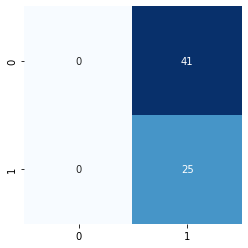

In [91]:
classifiers(doc2vec_data, labels, 'logistic')

randomforest
Accuracy = 0.3787878787878788
F1 Score = 0.4057971014492754


(None, None, <matplotlib.axes._subplots.AxesSubplot at 0x7fe29c3da760>)

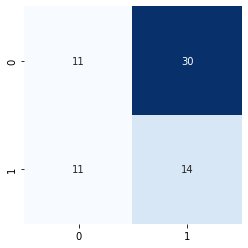

In [92]:
classifiers(doc2vec_data, labels, 'randomforest')

### Classification based on doc2vec 600

In [93]:
documents = [TaggedDocument(doc, [i]) for i, doc in enumerate(final_processed_text)]
model1 = Doc2Vec(documents, vectore_size = 600, window =2, min_count=1, workers=4)

In [94]:
doc2vec1_df=pd.DataFrame()
for i in range(0,len(processed_text)):
    vector=pd.DataFrame(model1.infer_vector(processed_text[i])).transpose()
    doc2vec1_df=pd.concat([doc2vec1_df,vector], axis=0)

doc2vec1_df=doc2vec1_df.reset_index()

doc_titles={'title': titles}
t=pd.DataFrame(doc_titles)

doc2vec1_df=pd.concat([doc2vec1_df,t], axis=1)

doc2vec1_df=doc2vec1_df.drop('index', axis=1)

In [95]:
doc2vec1_data=doc2vec1_df.drop('title', axis =1)
X_train_doc, X_test_doc, y_train_doc, y_test_doc = train_test_split(doc2vec1_data, labels, test_size=0.33, random_state=42)

In [96]:
labels = data['Review Type (pos or neg)'].apply(lambda x: 0 if x.lower().split(' ')[0] == 'negative' else 1)
print(labels)

0      1
1      1
2      1
3      1
4      1
      ..
195    0
196    0
197    0
198    0
199    0
Name: Review Type (pos or neg), Length: 200, dtype: int64


svm
Accuracy = 0.36363636363636365
F1 Score = 0.4615384615384615


(None, None, <matplotlib.axes._subplots.AxesSubplot at 0x7fe2a48d9370>)

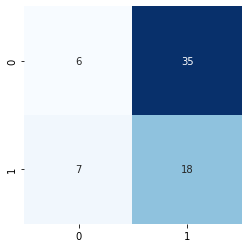

In [97]:
classifiers(doc2vec1_data, labels, 'svm')

logistic
Accuracy = 0.3787878787878788
F1 Score = 0.5494505494505494


(None, None, <matplotlib.axes._subplots.AxesSubplot at 0x7fe2a8ffa910>)

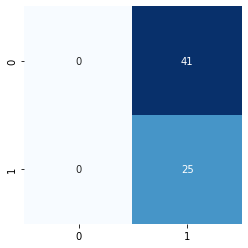

In [98]:
classifiers(doc2vec1_data, labels, 'logistic')

randomforest
Accuracy = 0.3939393939393939
F1 Score = 0.42857142857142855


(None, None, <matplotlib.axes._subplots.AxesSubplot at 0x7fe2a49534c0>)

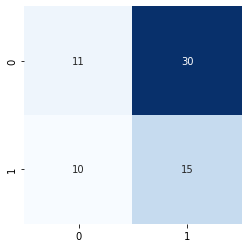

In [99]:
classifiers(doc2vec1_data, labels, 'randomforest')